### REFERENCE: [First Principles of Computer Vision: Image Stitching Playlist](https://www.youtube.com/playlist?list=PL2zRqk16wsdp8KbDfHKvPYNGF2L-zQASc)

In [1]:
import glob
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from scipy.ndimage import distance_transform_edt

### Helper Functions

In [2]:
def detect_sift_features(img):

    """Reference: CV2 Sift Features: https://docs.opencv.org/4.x/da/df5/tutorial_py_sift_intro.html"""

    gray= cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()    
    kp, des = sift.detectAndCompute(gray,None)
    return (kp, des)
    
def plot_image(img, figsize = None, gray=False):
    if figsize != None:
        plt.figure(figsize=figsize)
    else:
        plt.figure()
    if gray:
        plt.imshow(img, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    # plt.axis('off')
    # plt.show()

### Main

#### The issue with Homography Estimation - Non-overlapping images
![issue_homography](../../Images/issue_homography.png)

As visible in the figure above (WLOG, let `Img2` be the reference image), the overlapping pairs of images are:
- (`Img1`, `Img2`)
- (`Img2`, `Img3`)
- (`Img3`, `Img4`)

**Issue**: Homogrpahy estimation fails when finding a Homography Matrix $H_{24}$ as there is no overlapping region to reliably match features.

**Solution**: Estimate Homography Matrices for each pair of overlapping images. Since the Homography Matrices are *closed under composition*, one can estimate Homography Matrix for pairs of non-overlapping images. For example, $H_{23}$ and $H_{34}$ can be estimated because they are derived from pairs of overlapping images. Then,
$$H_{24} = H_{23}\times H_{34}$$

In [363]:
path = '../../Images/I2'
all_images = sorted(glob.glob(path+os.sep+'*'))
print('Found {} Images for stitching'.format(len(all_images)))

Found 5 Images for stitching


Query $\rightarrow$ Image1 (reference image)<br>
Train $\rightarrow$ Image2 (train image)

In [427]:
# def make_panaroma_for_images_in(self, path):

"""
Resources:
1) Feature Detection: https://docs.opencv.org/4.x/da/df5/tutorial_py_sift_intro.html
2) Feature Matching: https://docs.opencv.org/3.4/dc/dc3/tutorial_py_matcher.html
"""
query_image_idx = 1
train_image_idx = 2

# Feature detection
images_with_sift = []
for i in range(len(all_images)):
    img = cv2.imread(all_images[i])
    images_with_sift.append(detect_sift_features(img))

# Feature Matching
bf = cv2.BFMatcher()
matches = bf.knnMatch(images_with_sift[query_image_idx][1], images_with_sift[train_image_idx][1], k=2)
# Ratio Test
good = []
for m,n in matches:
    if m.distance < 0.75*n.distance:
        good.append([m])

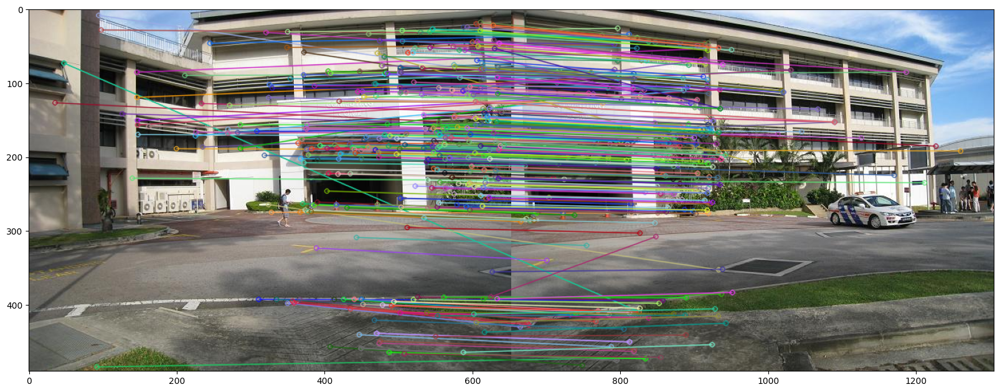

In [428]:
img3 = cv2.drawMatchesKnn(cv2.imread(all_images[query_image_idx]),images_with_sift[query_image_idx][0],cv2.imread(all_images[train_image_idx]),images_with_sift[train_image_idx][0],good,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plot_image(img3, figsize=(20,10))

Extracting Coords of Good Features

In [429]:
queries = []
train = []

for i in range(len(good)):
    queries.append(good[i][0].queryIdx)
    train.append(good[i][0].trainIdx)

In [458]:
len(queries), len(train)

(339, 339)

In [430]:
query_coords = []
train_coords = []

for i in range(len(good)):
    query_coords.append(images_with_sift[query_image_idx][0][queries[i]].pt)
    train_coords.append(images_with_sift[train_image_idx][0][train[i]].pt)

In [431]:
len(query_coords), len(train_coords), img3.shape

(339, 339, (490, 1306, 3))

In [432]:
# plot_image(img3, figsize = (20, 10))
# for i in range(len(query_coords)):
#     if i > 800 and i < 810:
#         plt.plot([query_coords[i][0], img3.shape[1]//2 + train_coords[i][0]], [query_coords[i][1], train_coords[i][1]], color='lightgreen')
#     plt.scatter(query_coords[i][0], query_coords[i][1], color='red', s =10)
#     plt.scatter(img3.shape[1]//2 + train_coords[i][0], train_coords[i][1], color='blue', s =10)
# plt.xlim(0, img3.shape[1])
# plt.ylim(img3.shape[0], 0)
# plt.show()

#### Homography Matrix Estimation - RANSAC

In [3]:
def RANSAC(query_coords, train_coords, epsilon = 5.0, s = 4, N = 1000):
    """
    RANSAC Algorithm to find the best homography matrix
    """
    best_inliers = []
    best_transform = None
    for i in tqdm(range(N)):
        # Randomly select s matches
        random_indices = np.random.choice(len(query_coords), s, replace=False)
        q = np.array([query_coords[i] for i in random_indices])
        t = np.array([train_coords[i] for i in random_indices])

        # Estimate homography matrix
        A = np.zeros((2*s, 9))
        for i in range(s):
            A[2*i] = np.array([-q[i][0], -q[i][1], -1, 0, 0, 0, q[i][0]*t[i][0], q[i][1]*t[i][0], t[i][0]])
            A[2*i+1] = np.array([0, 0, 0, -q[i][0], -q[i][1], -1, q[i][0]*t[i][1], q[i][1]*t[i][1], t[i][1]])
        
        U, S, V = np.linalg.svd(A)
        H = V[-1].reshape(3,3)

        # Calculate error
        inliers = []
        error = 0
        for i in range(len(query_coords)):
            q = np.array([query_coords[i][0], query_coords[i][1], 1])
            t = np.array([train_coords[i][0], train_coords[i][1], 1])
            t_ = np.dot(H, q)
            t_ = t_/t_[-1]
            error += np.linalg.norm(t-t_)
            if (np.linalg.norm(t-t_)) < epsilon:
                inliers.append(i)
        
        if len(inliers) > len(best_inliers):
            best_inliers = inliers
            best_transform = H
    
    A = np.zeros((2*len(best_inliers), 9))
    for i, inlier  in enumerate(best_inliers):
        A[2*i] = np.array([-query_coords[inlier][0], -query_coords[inlier][1], -1, 0, 0, 0, query_coords[inlier][0]*train_coords[inlier][0], query_coords[inlier][1]*train_coords[inlier][0], train_coords[inlier][0]])
        A[2*i+1] = np.array([0, 0, 0, -query_coords[inlier][0], -query_coords[inlier][1], -1, query_coords[inlier][0]*train_coords[inlier][1], query_coords[inlier][1]*train_coords[inlier][1], train_coords[inlier][1]])

    U, S, V = np.linalg.svd(A)
    best_transform = V[-1].reshape(3,3)
                                   
    return best_transform, best_inliers

In [434]:
H, inliers = RANSAC(query_coords, train_coords, epsilon = 5.0, s = 4, N = 1000)

100%|██████████| 1000/1000 [00:04<00:00, 234.44it/s]


In [435]:
H, len(inliers)

(array([[ 2.76356963e-03, -5.56996161e-05, -9.77374785e-01],
        [ 4.70745333e-04,  2.43977244e-03, -2.11476744e-01],
        [ 1.90869700e-06, -5.06798330e-08,  1.51747152e-03]]),
 216)

Plotting the inliers

In [436]:
# plot_image(img3, figsize = (20, 10))
# for i in range(len(query_coords)):
#     if i in inliers[1300:1320]:
#         plt.plot([query_coords[i][0], img3.shape[1]//2 + train_coords[i][0]], [query_coords[i][1], train_coords[i][1]], color='lightgreen')
#         plt.scatter(query_coords[i][0], query_coords[i][1], color='red', s =10)
#         plt.scatter(img3.shape[1]//2 + train_coords[i][0], train_coords[i][1], color='blue', s =10)

#### Warping and Coordinate Transform

In [437]:
H_inv = np.linalg.inv(H)
corners = np.array([[0,0,1], [0,img3.shape[0],1], [img3.shape[1]//2, img3.shape[0],1], [img3.shape[1]//2, 0, 1]])
corners_ = np.dot(H_inv, corners.T).T
corners_ = corners_/corners_[:,2].reshape(-1,1)
corners_

array([[ 3.54034122e+02,  1.83692677e+01,  1.00000000e+00],
       [ 3.62852328e+02,  4.55889816e+02,  1.00000000e+00],
       [ 1.30676474e+03,  6.33793579e+02,  1.00000000e+00],
       [ 1.29489028e+03, -1.63165551e+02,  1.00000000e+00]])

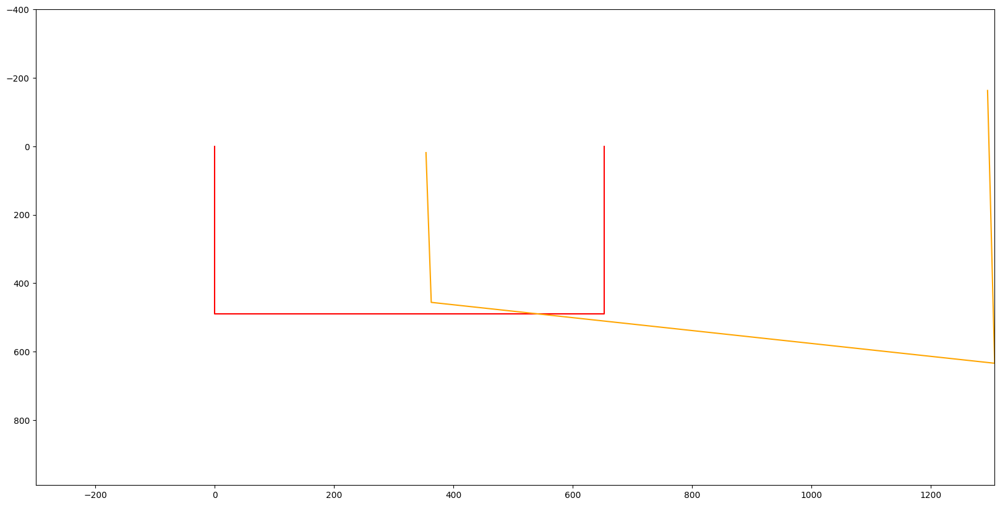

In [438]:
plt.figure(figsize=(20,10))
plt.plot(corners[:,0], corners[:,1], color='red')
plt.plot(corners_[:,0], corners_[:,1], color='orange')
plt.xlim(-300, img3.shape[1])
plt.ylim(img3.shape[0]+500, -400)
plt.show()

Get Bounding Box/Canvas Size

![canvas](../../Images/canvas.png)

In [439]:
all_corners = np.concatenate([corners[:, :2], corners_[:, :2]], axis=0)
min_x = int(np.min(all_corners[:,0]))
max_x = int(np.max(all_corners[:,0]))
min_y = int(np.min(all_corners[:,1]))
max_y = int(np.max(all_corners[:,1]))

In [440]:
min_x, max_x, min_y, max_y

(0, 1306, -163, 633)

![coord_transform](../../Images/coord_transform.png)

In [441]:
def coordinate_transform(img, H):
    H_inv = np.linalg.inv(H)
    X, Y = np.meshgrid(np.arange(img.shape[1]), np.arange(img.shape[0]))
    pixels = np.array([X.flatten(), Y.flatten(), np.ones(X.size)]).reshape(3, X.shape[0], X.shape[1])
    new_pixels = np.tensordot(H_inv, pixels, axes=(1, 0))
    new_pixels = new_pixels/new_pixels[-1]
    return new_pixels
    
new_pixels = coordinate_transform(cv2.imread(all_images[train_image_idx]), H)

Warping Image

![bilinear_interp](../../Images/warp_bil_interp.png)

In [442]:
def bilinear_interpolation(img, x, y, p):
    i, j = p[0], p[1]
    h, w, c = img.shape
    if i < x + 0.5 and j < y + 0.5:
        x1 = x - 1
        y1 = y
        x2 = x
        y2 = y - 1
    elif i < x + 0.5 and j >= y + 0.5:
        x1 = x - 1
        y1 = y + 1
        x2 = x
        y2 = y
    elif i >= x + 0.5 and j < y + 0.5:
        x1 = x
        y1 = y
        x2 = x + 1
        y2 = y - 1
    else:
        x1 = x
        y1 = y + 1
        x2 = x + 1
        y2 = y
    
    Ix1y1 = img[y1, x1, :] if x1 >= 0 and y1 >= 0 and x1 < img.shape[1] and y1 < img.shape[0] else 0
    Ix2y1 = img[y1, x2, :] if x2 >= 0 and y1 >= 0 and x2 < img.shape[1] and y1 < img.shape[0] else 0
    Ix1y2 = img[y2, x1, :] if x1 >= 0 and y2 >= 0 and x1 < img.shape[1] and y2 < img.shape[0] else 0
    Ix2y2 = img[y2, x2, :] if x2 >= 0 and y2 >= 0 and x2 < img.shape[1] and y2 < img.shape[0] else 0

    I = np.zeres(c)
    for k in range(c):
        I[k] =  1/(x2-x1)/(y2-y1) * np.array([x2-i, i-x1]).dot(np.array([[Ix1y1[k], Ix2y1[k]], [Ix1y2[k], Ix2y2[k]]]).dot(np.array([y2-j, j-y1])))
    return I


def warp(img, H, dsize):
    """
    Reference: https://en.wikipedia.org/wiki/Bilinear_interpolation
    """

    new_img = np.zeros((dsize[1], dsize[0], 3), dtype=np.uint8)

    for i in range(dsize[1]):
        for j in range(dsize[0]):
            p = np.array([i, j, 1])
            p_ = np.dot(H, p)
            p_ = p_/p_[-1]
            x, y = int(p_[0]), int(p_[1])
            if x >= 0 and x < img.shape[1] and y >= 0 and y < img.shape[0]:
                # Bilinear Interpolation
                new_img[j, i, :] = bilinear_interpolation(img, x, y, p_)
    return new_img

In [443]:
translation = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
warped = cv2.warpPerspective(cv2.imread(all_images[train_image_idx]), translation @ H_inv, (max_x-min_x, max_y-min_y))

In [444]:
warped.shape

(796, 1306, 3)

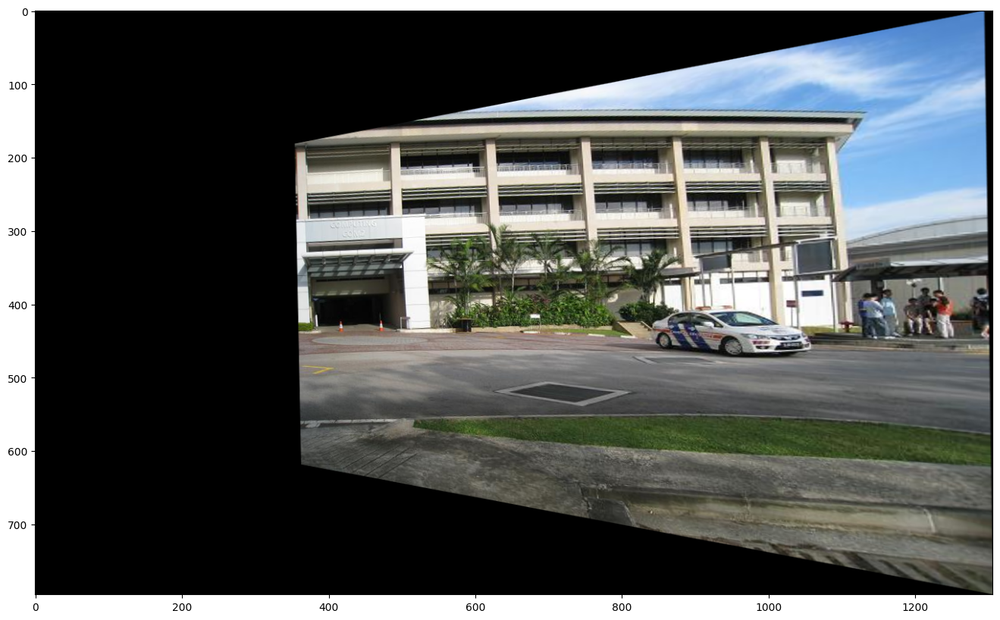

In [445]:
plot_image(warped, figsize=(20,10))

In [446]:
translation = translation.astype(np.float32)
original = cv2.warpPerspective(cv2.imread(all_images[query_image_idx]), translation, (max_x-min_x, max_y-min_y))

In [447]:
original.shape

(796, 1306, 3)

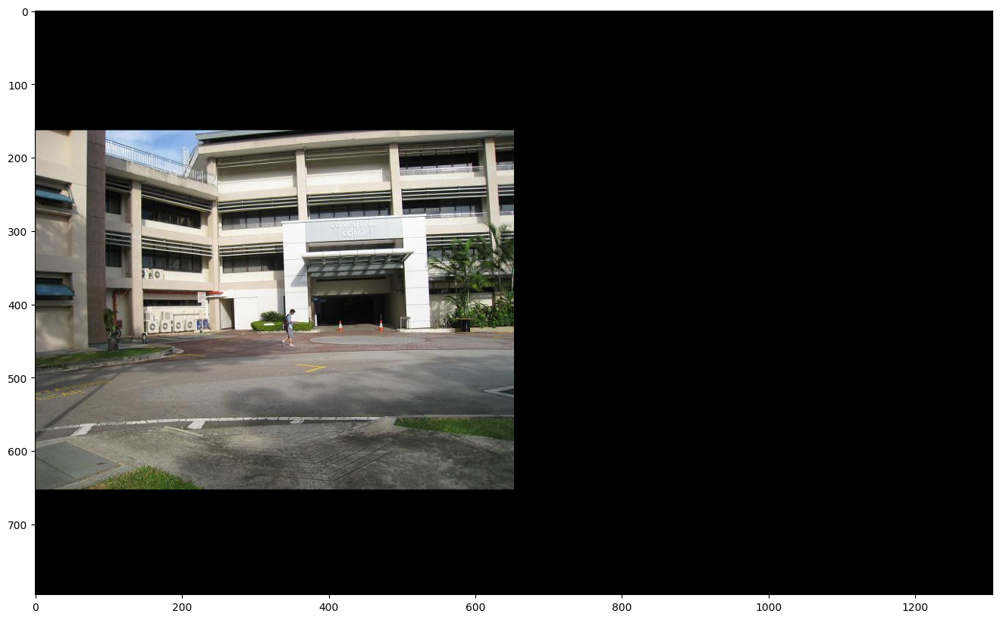

In [448]:
plot_image(original, figsize=(20,10))

In [449]:
pre_final = original.copy()
pre_final[warped>0] = warped[warped>0]

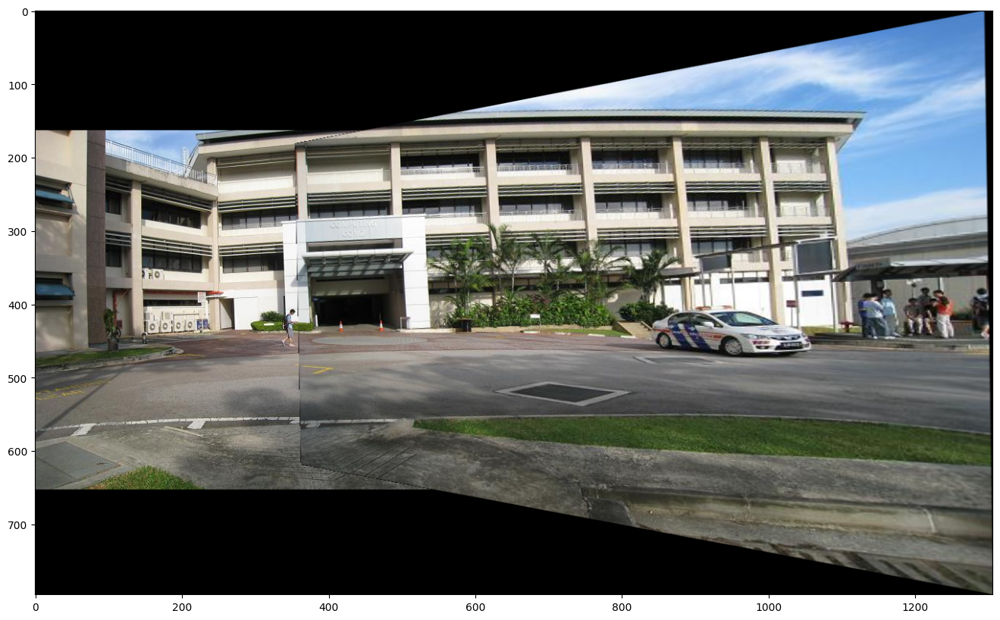

In [450]:
plot_image(pre_final, figsize=(20,10))

#### Blending

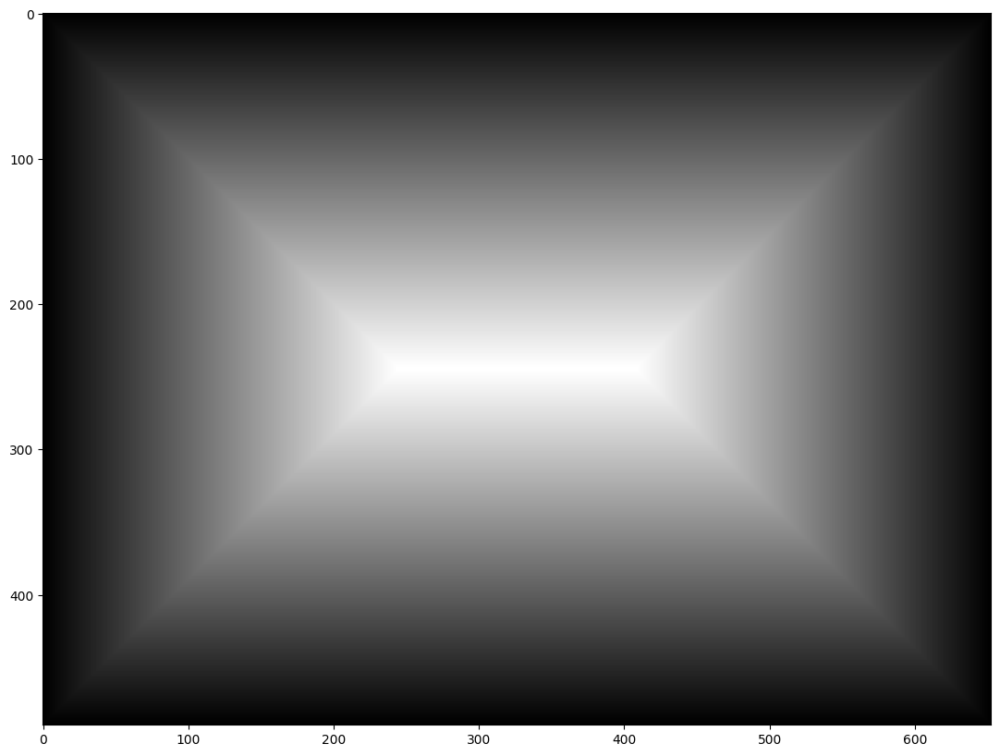

In [451]:
"""
References: 
https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.distance_transform_edt.html
https://github.com/CorentinBrtx/image-stitching/tree/main
"""
h, w, c = cv2.imread(all_images[query_image_idx]).shape
base = np.zeros((h, w))
base[1:h-1, 1:w-1] = 1
mask = distance_transform_edt(base)
plot_image(mask, figsize=(20,10), gray=True)

In [4]:
def single_weights_array(size: int) -> np.ndarray:
    """
    Create a 1D weights array.

    Args:
        size: Size of the array

    Returns:
        weights: 1D weights array
    """
    if size % 2 == 1:
        return np.concatenate(
            [np.linspace(0, 1, (size + 1) // 2), np.linspace(1, 0, (size + 1) // 2)[1:]]
        )
    else:
        return np.concatenate([np.linspace(0, 1, size // 2), np.linspace(1, 0, size // 2)])


def single_weights_matrix(shape: tuple[int]) -> np.ndarray:
    """
    Create a 2D weights matrix.

    Args:
        shape: Shape of the matrix

    Returns:
        weights: 2D weights matrix
    """
    return (
        single_weights_array(shape[0])[:, np.newaxis]
        @ single_weights_array(shape[1])[:, np.newaxis].T
    )

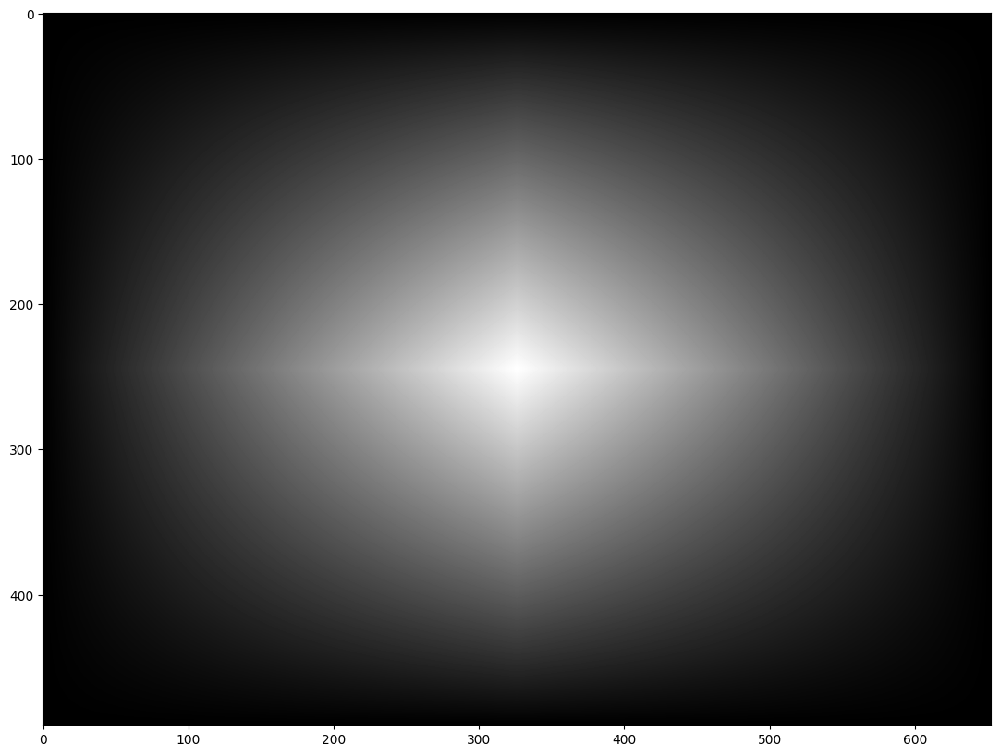

In [453]:
mask = single_weights_matrix(mask.shape)
plot_image(mask, figsize=(20,10), gray=True)

In [454]:
mask1 = cv2.warpPerspective(mask, translation, (max_x-min_x, max_y-min_y))
mask2 = cv2.warpPerspective(mask, translation @ H_inv, (max_x-min_x, max_y-min_y))

# plot_image(mask1, figsize=(20,10), gray=True)
# plot_image(mask2, figsize=(20,10), gray=True)

mask1 = mask1/mask1.max()
mask2 = mask2/mask2.max()

mask1 = np.array([mask1, mask1, mask1]).transpose(1,2,0)
mask2 = np.array([mask2, mask2, mask2]).transpose(1,2,0)

In [455]:
normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
normalized_mask = normalized_mask/normalized_mask.max()

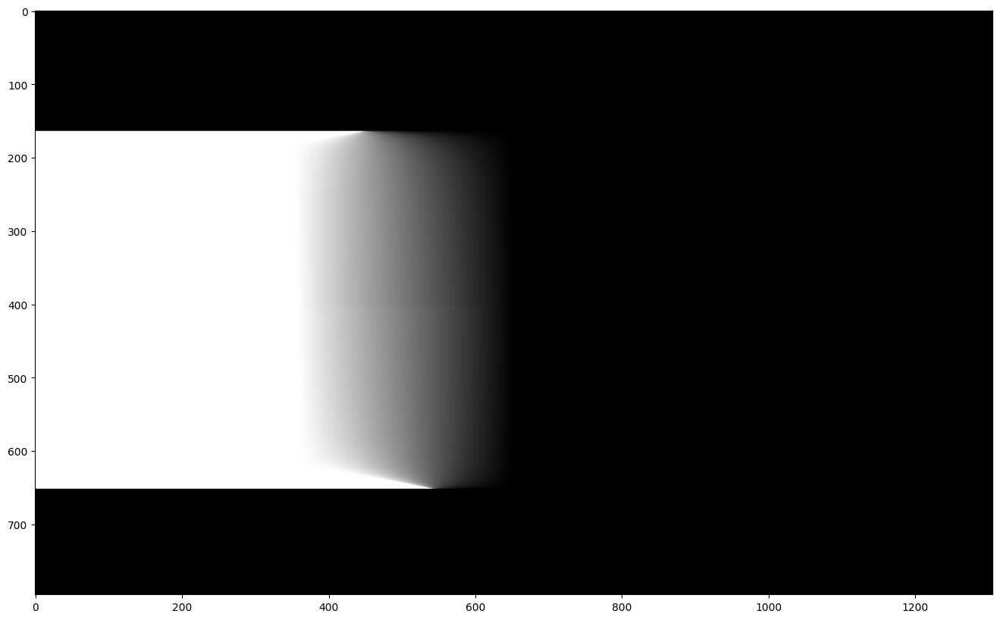

In [456]:
plot_image(normalized_mask, figsize=(20,10), gray=True)

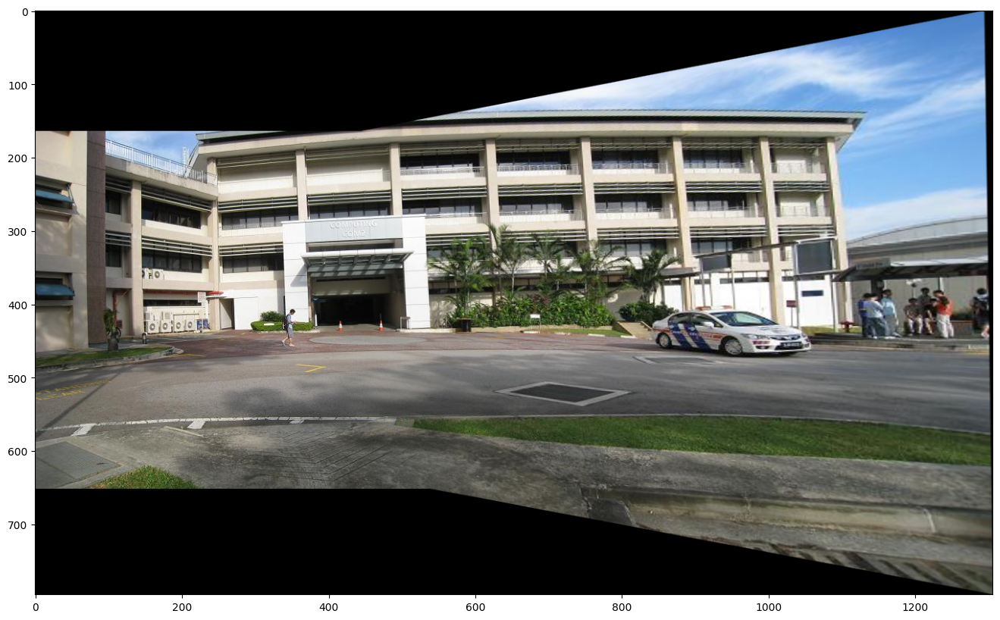

In [457]:
blended = normalized_mask * original + (1-normalized_mask) * warped
blended = blended.astype(np.uint8)
plot_image(blended, figsize=(20,10))

# SEMI-GOD FUNCTION

In [2]:
import glob
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

In [3]:
def detect_sift_features(img):

    """Reference: CV2 Sift Features: https://docs.opencv.org/4.x/da/df5/tutorial_py_sift_intro.html"""

    gray= cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()    
    kp, des = sift.detectAndCompute(gray,None)
    return (kp, des)
    
def plot_image(img, figsize = None, gray=False):
    if figsize != None:
        plt.figure(figsize=figsize)
    else:
        plt.figure()
    if gray:
        plt.imshow(img, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    # plt.axis('off')
    plt.show()

In [4]:
def RANSAC(query_coords, train_coords, epsilon = 5.0, s = 4, N = 1000):
    """
    RANSAC Algorithm to find the best homography matrix
    """
    best_inliers = []
    best_transform = None
    for i in tqdm(range(N)):
        # Randomly select s matches
        random_indices = np.random.choice(len(query_coords), s, replace=False)
        q = np.array([query_coords[i] for i in random_indices])
        t = np.array([train_coords[i] for i in random_indices])

        # Estimate homography matrix
        A = np.zeros((2*s, 9))
        for i in range(s):
            A[2*i] = np.array([-q[i][0], -q[i][1], -1, 0, 0, 0, q[i][0]*t[i][0], q[i][1]*t[i][0], t[i][0]])
            A[2*i+1] = np.array([0, 0, 0, -q[i][0], -q[i][1], -1, q[i][0]*t[i][1], q[i][1]*t[i][1], t[i][1]])
        
        U, S, V = np.linalg.svd(A)
        H = V[-1].reshape(3,3)
        
        q = np.hstack([np.array(query_coords), np.ones((len(query_coords), 1))])
        t_ = np.dot(H, q.T).T
        t_ = t_[:, :2] / t_[:, 2:]

        # Compute the number of inliers
        distances = np.linalg.norm(t_ - np.array(train_coords), axis=1)
        inliers = distances < epsilon
        if np.sum(inliers) > len(best_inliers):
            best_inliers = np.linspace(0, len(inliers), len(inliers), endpoint=False, dtype = np.int64)[inliers]
            best_transform = H
    
    A = np.zeros((2*len(best_inliers), 9))
    for i, inlier  in enumerate(best_inliers):
        A[2*i] = np.array([-query_coords[inlier][0], -query_coords[inlier][1], -1, 0, 0, 0, query_coords[inlier][0]*train_coords[inlier][0], query_coords[inlier][1]*train_coords[inlier][0], train_coords[inlier][0]])
        A[2*i+1] = np.array([0, 0, 0, -query_coords[inlier][0], -query_coords[inlier][1], -1, query_coords[inlier][0]*train_coords[inlier][1], query_coords[inlier][1]*train_coords[inlier][1], train_coords[inlier][1]])

    U, S, V = np.linalg.svd(A)
    best_transform = V[-1].reshape(3,3)
                                   
    return best_transform, best_inliers

In [5]:
def single_weights_array(size: int) -> np.ndarray:
    if size % 2 == 1:
        return np.concatenate(
            [np.linspace(0, 1, (size + 1) // 2), np.linspace(1, 0, (size + 1) // 2)[1:]]
        )
    else:
        return np.concatenate([np.linspace(0, 1, size // 2), np.linspace(1, 0, size // 2)])


def single_weights_matrix(shape: tuple[int]) -> np.ndarray:
    return (
        single_weights_array(shape[0])[:, np.newaxis]
        @ single_weights_array(shape[1])[:, np.newaxis].T
    )

In [8]:
def stitch(path, a, b, verbose = False):
    all_images = sorted(glob.glob(path+os.sep+'*'))
    if verbose:
        print('Found {} Images for stitching'.format(len(all_images)))

    query_image_idx = a
    train_image_idx = b

    # Feature detection
    images_with_sift = []
    for i in range(len(all_images)):
        img = cv2.imread(all_images[i])
        images_with_sift.append(detect_sift_features(img))
    if verbose:
        print('Feature Detection Done')

    # Feature Matching
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(images_with_sift[query_image_idx][1], images_with_sift[train_image_idx][1], k=2)
    # Ratio Test
    good = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good.append([m])
    if verbose:
        print('Feature Matching Done')

    # Feature Coodinates Extraction 
    query_coords = []
    train_coords = []
    for i in range(len(good)):
        query_coords.append(images_with_sift[query_image_idx][0][good[i][0].queryIdx].pt)
        train_coords.append(images_with_sift[train_image_idx][0][good[i][0].trainIdx].pt)
    if verbose:
        print('Feature Coordinates Extraction Done')

    # Homography Estimation
    H, inliers = RANSAC(query_coords, train_coords, epsilon = 5.0, s = 4, N = 1000)
    if verbose:
        print('Homography Estimation Done')

    # # Canvas Size Calculation
    # H_inv = np.linalg.inv(H)
    # corners = np.array([[0,0,1], [0,img.shape[0],1], [img.shape[1], img.shape[0],1], [img.shape[1], 0, 1]])
    # corners_ = np.dot(H_inv, corners.T).T
    # corners_ = corners_/corners_[:,2].reshape(-1,1)
    # corners_

    # all_corners = np.concatenate([corners[:, :2], corners_[:, :2]], axis=0)
    # min_x = int(np.min(all_corners[:,0]))
    # max_x = int(np.max(all_corners[:,0]))
    # min_y = int(np.min(all_corners[:,1]))
    # max_y = int(np.max(all_corners[:,1]))
    # if verbose:
    #     print('Canvas Size Calculation Done')

    # # Image Warping
    # translation = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
    # train_warped = cv2.warpPerspective(cv2.imread(all_images[train_image_idx]), translation @ H_inv, (max_x-min_x, max_y-min_y))

    # translation = translation.astype(np.float32)
    # query_warped = cv2.warpPerspective(cv2.imread(all_images[query_image_idx]), translation, (max_x-min_x, max_y-min_y))
    # if verbose:
    #     print('Image Warping Done')

    # # Blending
    # mask = single_weights_matrix(img.shape[:2])

    # mask1 = cv2.warpPerspective(mask, translation, (max_x-min_x, max_y-min_y))
    # mask2 = cv2.warpPerspective(mask, translation @ H_inv, (max_x-min_x, max_y-min_y))

    # mask1 = mask1/mask1.max()
    # mask2 = mask2/mask2.max()

    # normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
    # normalized_mask = normalized_mask/normalized_mask.max()

    # normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)

    # blended = normalized_mask * query_warped + (1-normalized_mask) * train_warped
    # blended = blended.astype(np.uint8)

    # if verbose:
    #     print('Blending Done')
    return  H #, blended, translation, (mask1 + mask2)/(mask1 + mask2).max()

In [9]:
path = '../../Images/I5'
# blended_images = []
H_matrices = []
# translation_matrices = []
# weights = []
for i in range(len(os.listdir(path))-1):
    H = stitch(path, i, i+1, verbose = False) # stitched_img, translation, weight
    # blended_images.append(stitched_img)
    H_matrices.append(H)
    # translation_matrices.append(translation)
    # weights.append(weight)

100%|██████████| 1000/1000 [00:02<00:00, 419.64it/s]


In [10]:
all_images = sorted(glob.glob(path+os.sep+'*'))
images = []
for i in range(len(all_images)):
    img = cv2.imread(all_images[i])
    images.append(img)

In [192]:
query_image_idx = 2
train_image_idx = 3

In [136]:
h3 = H_matrices[query_image_idx]
for i in range(query_image_idx+1, train_image_idx):
    h3 = h3 @ H_matrices[i]
    h3 = h3/h3[-1,-1]
h3

array([[-4.85648378e-03,  2.21356147e-04,  9.99191529e-01],
       [-3.52010005e-04, -4.35395200e-03, -3.94891256e-02],
       [-1.87363508e-06,  5.51062869e-07, -3.76581905e-03]])

In [104]:
h34 = H_matrices[3]
h34 = h34/h34[-1,-1]
h34

array([[ 1.34473077e+00,  3.10641542e-02, -8.44640345e+02],
       [ 9.58802541e-02,  1.23670968e+00, -1.96772126e+02],
       [ 1.71399992e-04,  1.82038352e-05,  1.00000000e+00]])

In [105]:
# Canvas Size Calculation
H_inv34 = np.linalg.inv(h34)
corners = np.array([[0,0,1], [0,img.shape[0],1], [img.shape[1], img.shape[0],1], [img.shape[1], 0, 1]])
corners_ = np.dot( H_inv34, corners.T).T # translation_matrices[2] @
corners_ = corners_/corners_[:,2].reshape(-1,1)
corners_

canvas_shape = img.shape # blended_images[2]
canvas_corners = np.array([[0,0,1], [0,canvas_shape[0],1], [canvas_shape[1], canvas_shape[0],1], [canvas_shape[1], 0, 1]])
all_corners = np.concatenate([canvas_corners[:, :2], corners_[:, :2]], axis=0)
min_x = int(np.min(all_corners[:,0]))
max_x = int(np.max(all_corners[:,0]))
min_y = int(np.min(all_corners[:,1]))
max_y = int(np.max(all_corners[:,1]))

In [106]:
all_corners

array([[   0.        ,    0.        ],
       [   0.        , 1329.        ],
       [2000.        , 1329.        ],
       [2000.        ,    0.        ],
       [ 625.55593273,  110.61097558],
       [ 597.54068625, 1323.35810687],
       [2847.52175442, 1568.13472374],
       [2838.83332309,  -60.98111397]])

In [107]:
min_x, max_x, min_y, max_y

(0, 2847, -60, 1568)

In [ ]:
# Image Warping
translation = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
train_warped = cv2.warpPerspective(cv2.imread(all_images[1]), translation_matrices[2] @ translation @ H_inv, (max_x-min_x, max_y-min_y))

translation = translation.astype(np.float32)
query_warped = cv2.warpPerspective(blended_images[2], translation, (max_x-min_x, max_y-min_y))

# Blending
mask = single_weights_matrix(img.shape[:2])

mask1 = cv2.warpPerspective(weights[2], translation, (max_x-min_x, max_y-min_y))
mask2 = cv2.warpPerspective(mask,  translation_matrices[2]  @  translation @ H_inv, (max_x-min_x, max_y-min_y))

mask1 = mask1/mask1.max()
mask2 = mask2/mask2.max()

normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
normalized_mask = normalized_mask/normalized_mask.max()

normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)

blended = normalized_mask * query_warped + (1-normalized_mask) * train_warped
blended = blended.astype(np.uint8)


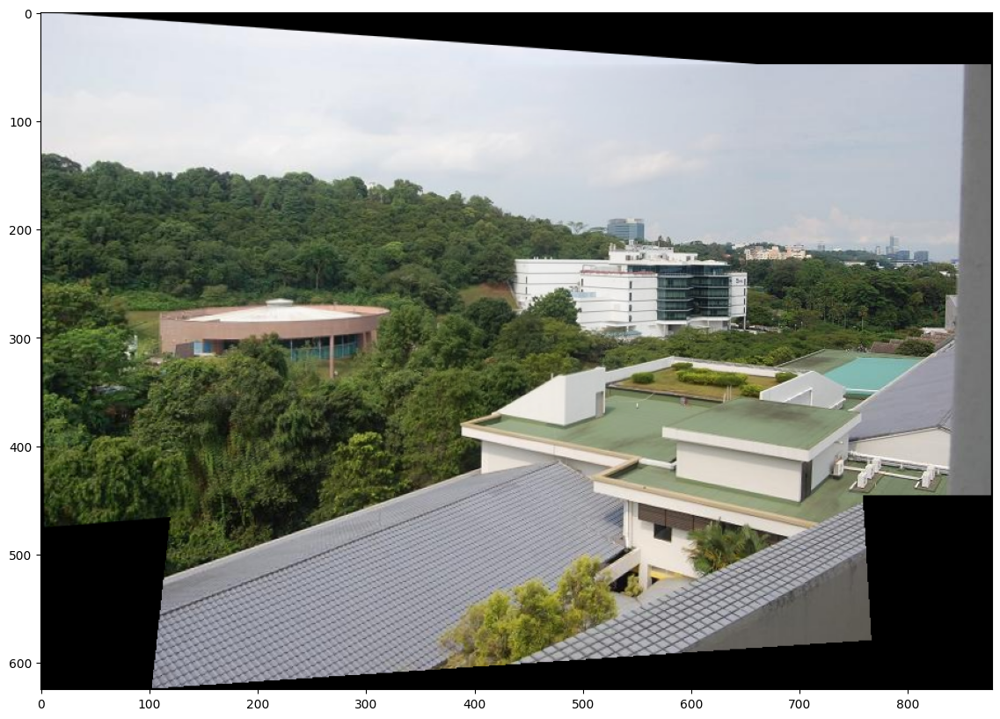

In [217]:
plot_image(blended, figsize=(20,10))

In [108]:
translation34 = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
train_warped = cv2.warpPerspective(cv2.imread(all_images[4]), translation34 @ H_inv34, (max_x-min_x, max_y-min_y))

translation34 = translation34.astype(np.float32)
query_warped = cv2.warpPerspective(cv2.imread(all_images[3]), translation34, (max_x-min_x, max_y-min_y))


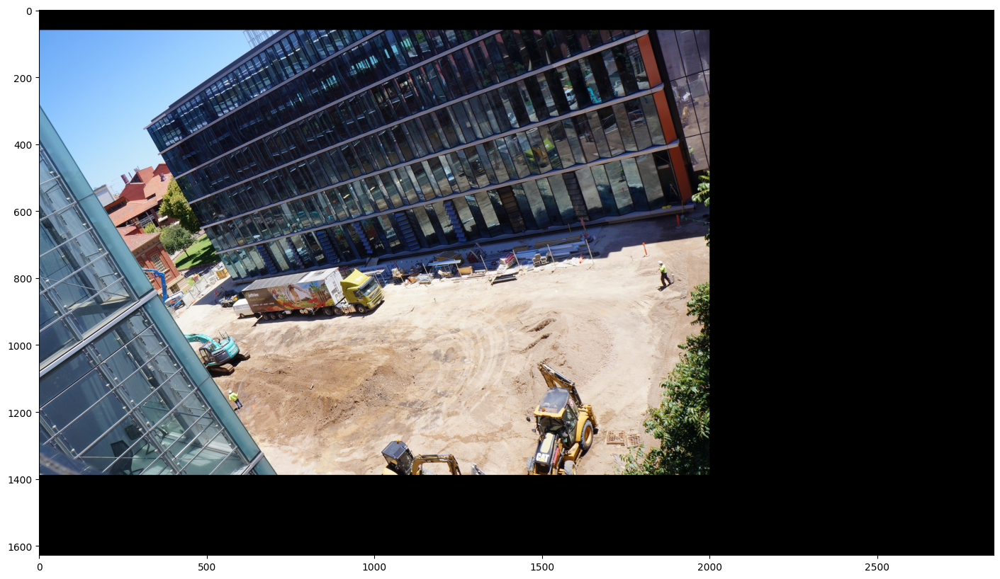

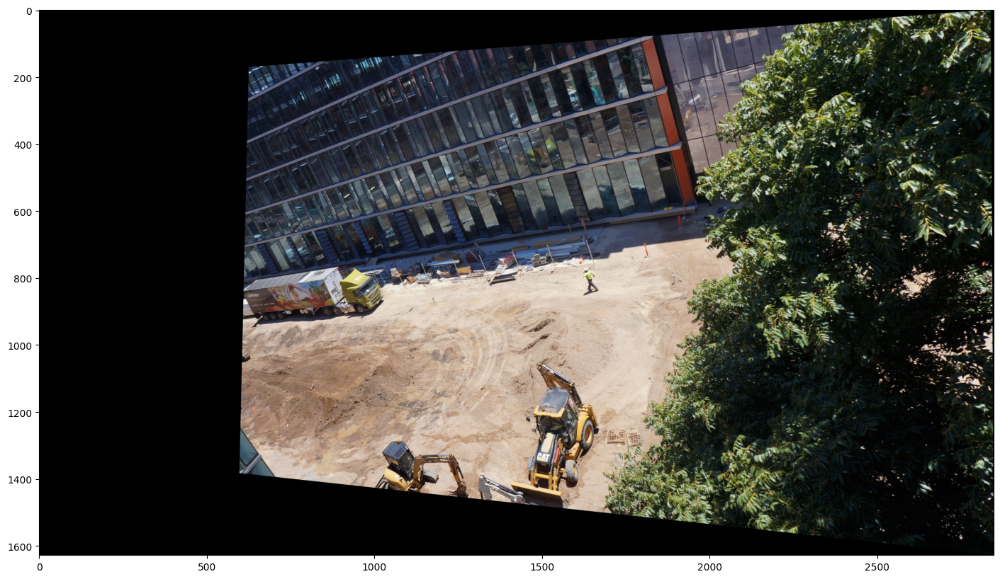

In [109]:
plot_image(query_warped, figsize=(20,10))
plot_image(train_warped, figsize=(20,10))

In [110]:
# Blending
mask = single_weights_matrix(img.shape[:2])

mask1 = cv2.warpPerspective(mask, translation34, (max_x-min_x, max_y-min_y))
mask2 = cv2.warpPerspective(mask,  translation34 @ H_inv34, (max_x-min_x, max_y-min_y))

mask1 = mask1/mask1.max()
mask2 = mask2/mask2.max()

normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
normalized_mask = normalized_mask/normalized_mask.max()

normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)

blended34 = normalized_mask * query_warped + (1-normalized_mask) * train_warped
blended34 = blended34.astype(np.uint8)
weights34 = (mask1 + mask2)/(mask1 + mask2).max()

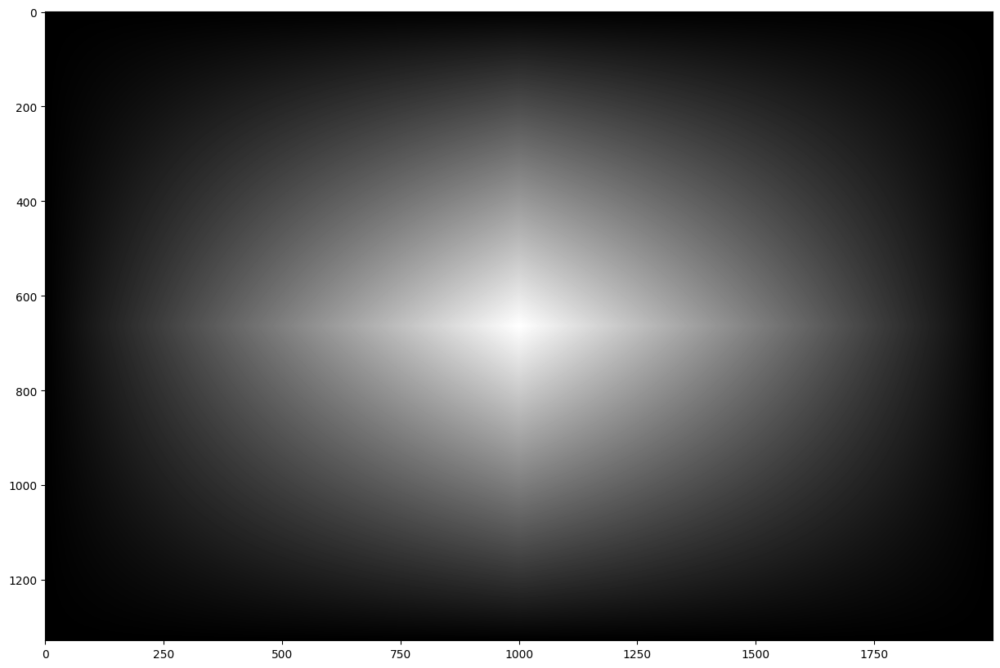

In [111]:
plot_image(mask, figsize=(20,10), gray=True)

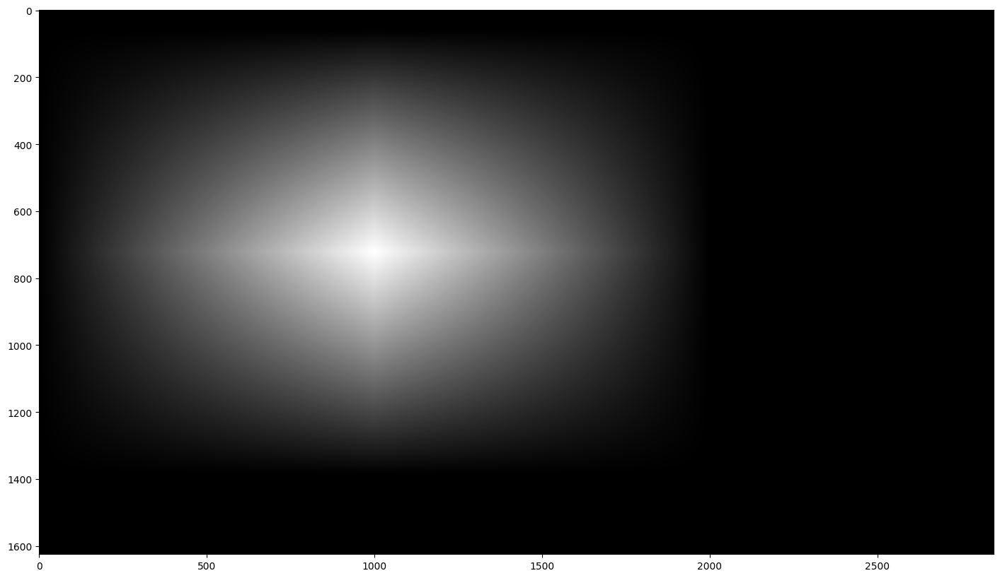

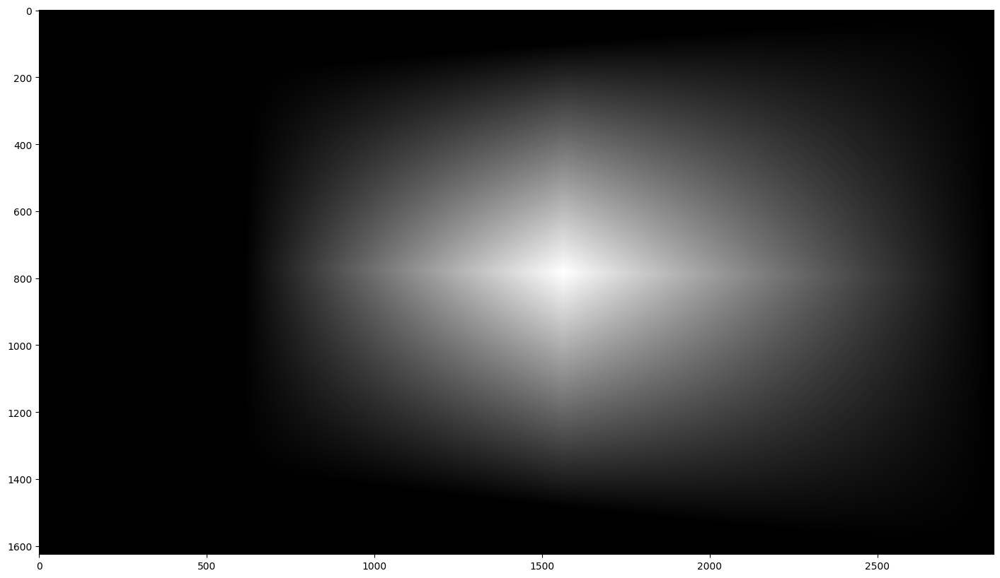

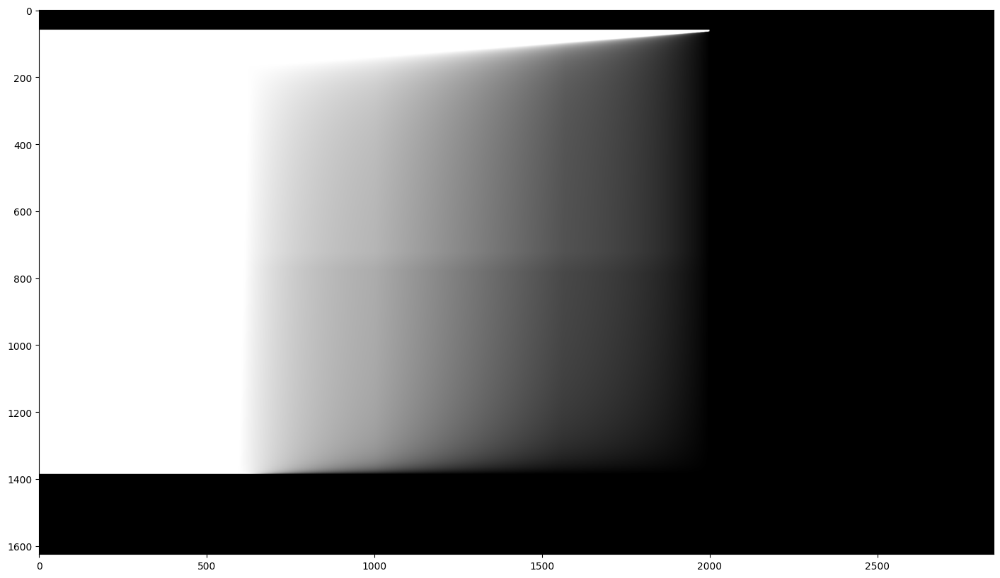

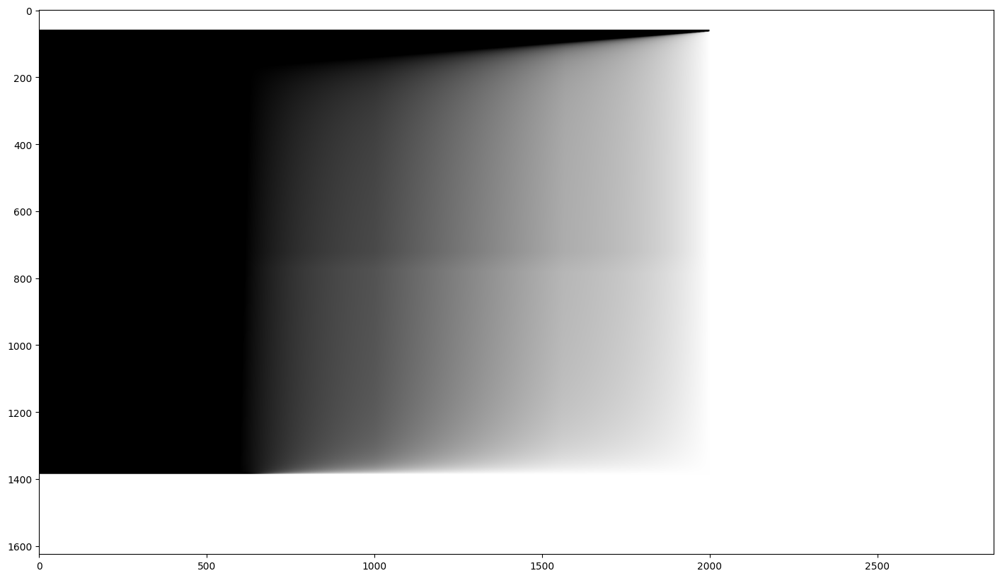

In [53]:
plot_image(mask1, figsize=(20,10), gray=True)
plot_image(mask2, figsize=(20,10), gray=True)
plot_image(normalized_mask, figsize=(20,10), gray=True)
plot_image(1-normalized_mask, figsize=(20,10), gray=True)

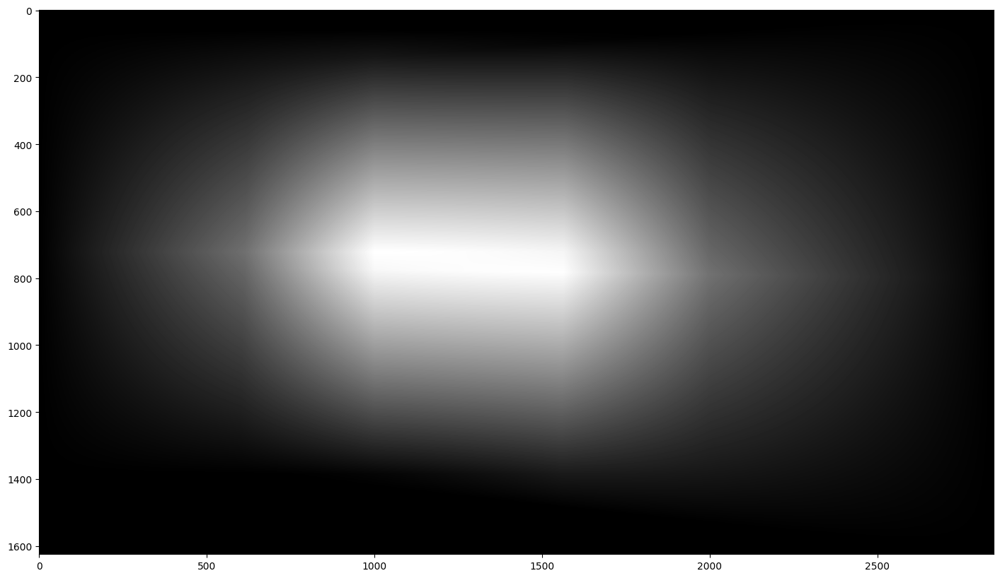

In [16]:
plot_image(weights34, figsize=(20,10), gray=True)

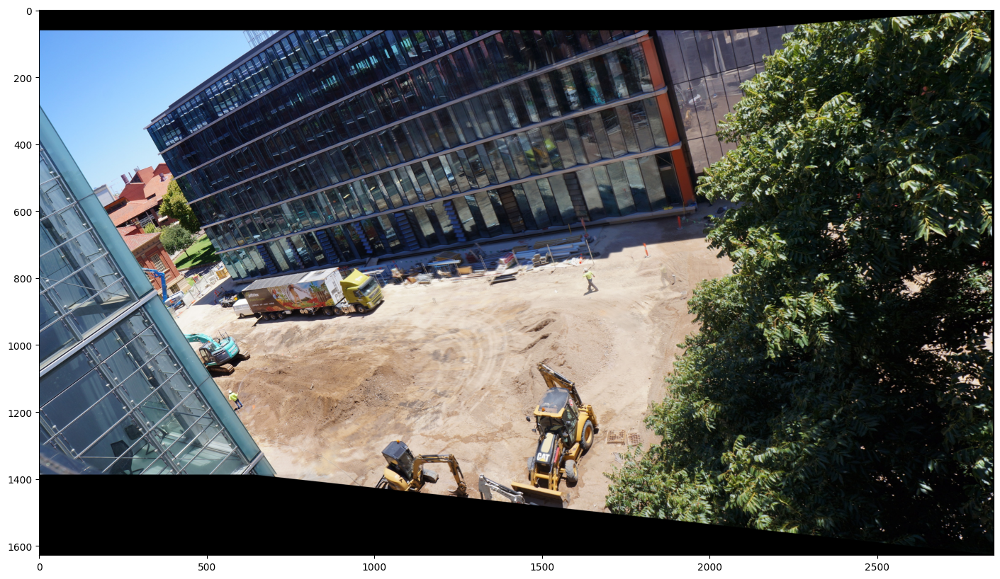

In [112]:
plot_image(blended34, figsize=(20,10))

In [18]:
h23 = H_matrices[2]
h23 = h23/h23[-1,-1]
h23

array([[ 1.24275362e+00,  5.09119698e-02, -5.69397761e+02],
       [ 3.46245441e-02,  1.15651845e+00, -1.23277815e+02],
       [ 1.15680129e-04,  1.94034060e-05,  1.00000000e+00]])

In [19]:
# Canvas Size Calculation
H_inv23 = np.linalg.inv(h23)
corners = np.array([[0,0,1], [0,blended34.shape[0],1], [blended34.shape[1], blended34.shape[0],1], [blended34.shape[1], 0, 1]])
corners_ = np.dot(H_inv23 @ np.linalg.inv(translation34), corners.T).T # translation_matrices[2] @
corners_ = corners_/corners_[:,2].reshape(-1,1)
corners_

canvas_shape = img.shape # blended_images[2]
canvas_corners = np.array([[0,0,1], [0,canvas_shape[0],1], [canvas_shape[1], canvas_shape[0],1], [canvas_shape[1], 0, 1]])
all_corners = np.concatenate([canvas_corners[:, :2], corners_[:, :2]], axis=0)
min_x = int(np.min(all_corners[:,0]))
max_x = int(np.max(all_corners[:,0]))
min_y = int(np.min(all_corners[:,1]))
max_y = int(np.max(all_corners[:,1]))

In [20]:
all_corners

array([[   0.        ,    0.        ],
       [   0.        , 1329.        ],
       [2000.        , 1329.        ],
       [2000.        ,    0.        ],
       [ 456.53200741,   40.08791215],
       [ 394.57836675, 1552.36708391],
       [3748.07447772, 1989.07049024],
       [3738.3261119 ,  -77.08944767]])

In [21]:
min_x, max_x, min_y, max_y

(0, 3748, -77, 1989)

In [22]:
translation23 = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
train_warped = cv2.warpPerspective(blended34, translation23 @ H_inv23 @ np.linalg.inv(translation34), (max_x-min_x, max_y-min_y))

translation23 = translation23.astype(np.float32)
query_warped = cv2.warpPerspective(cv2.imread(all_images[2]), translation23, (max_x-min_x, max_y-min_y))


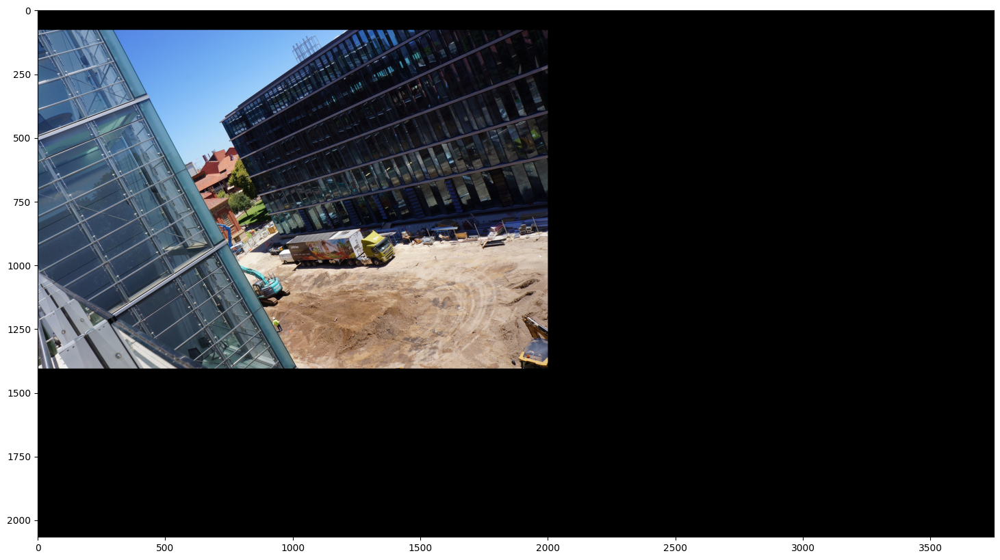

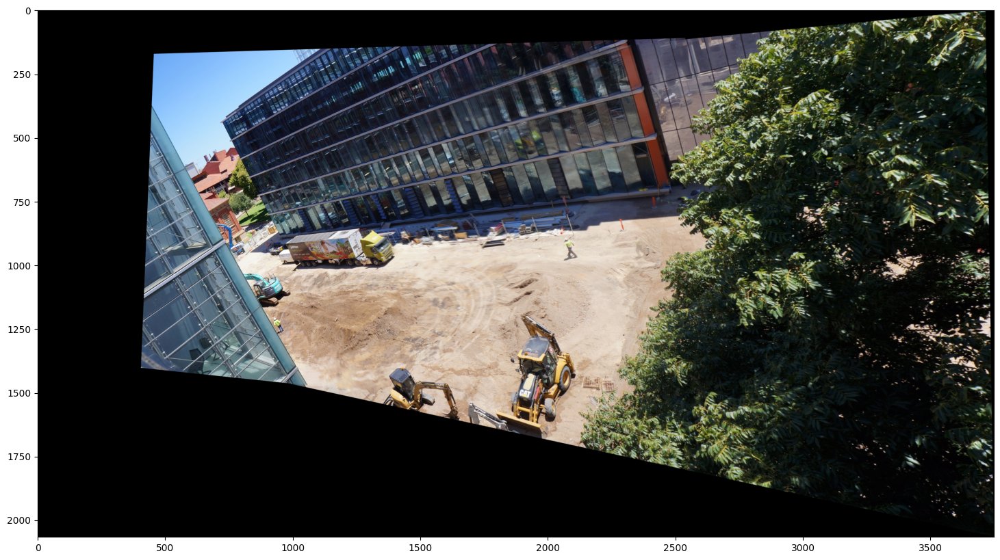

In [23]:
plot_image(query_warped, figsize=(20,10))
plot_image(train_warped, figsize=(20,10))

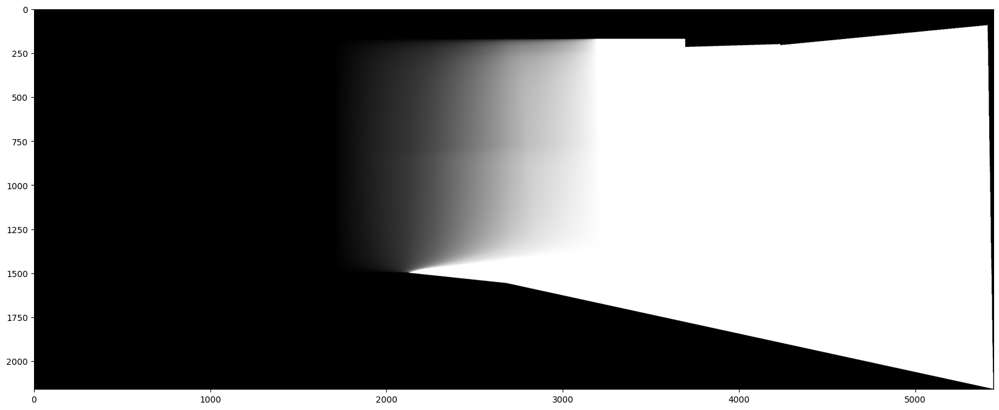

In [44]:
plot_image(normalized_mask, figsize=(20,10), gray=True)

In [24]:
# Blending
mask = single_weights_matrix(img.shape[:2])

mask1 = cv2.warpPerspective(mask, translation23, (max_x-min_x, max_y-min_y))
mask2 = cv2.warpPerspective(weights34,  translation23 @ H_inv23 @ np.linalg.inv(translation34), (max_x-min_x, max_y-min_y))

mask1 = mask1/mask1.max()
mask2 = mask2/mask2.max()

normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
normalized_mask = normalized_mask/normalized_mask.max()

normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)

blended234 = normalized_mask * query_warped + (1-normalized_mask) * train_warped
blended234 = blended234.astype(np.uint8)
weights234 = (mask1 + mask2)/(mask1 + mask2).max()

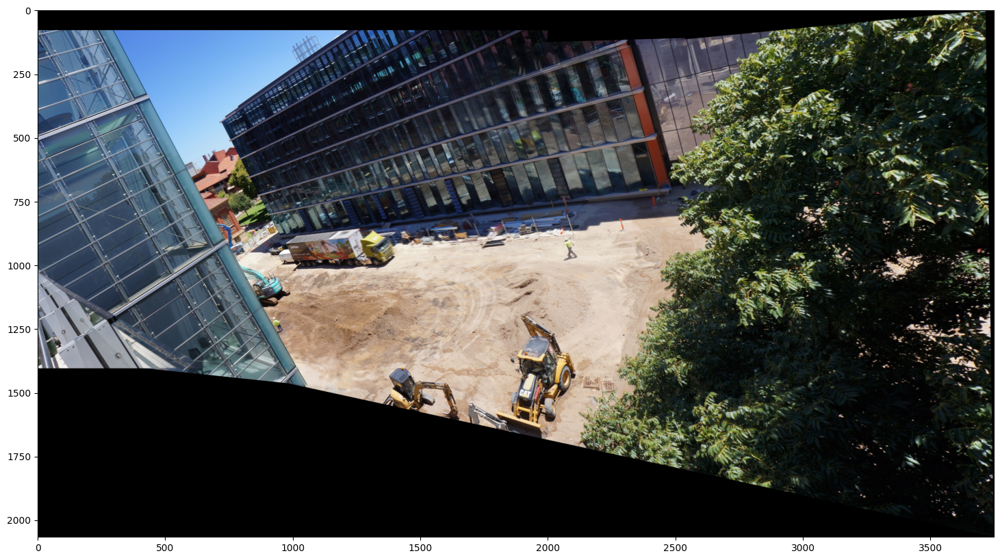

In [25]:
plot_image(blended234, figsize=(20,10))

In [26]:
h01 = np.linalg.inv(H_matrices[0])
h01 = h01/h01[-1,-1]
h01

array([[ 7.81248114e-01, -4.59856949e-02,  5.06728705e+02],
       [-1.97488451e-02,  9.25508185e-01, -6.71135849e+00],
       [-1.03234069e-04,  2.27671116e-06,  1.00000000e+00]])

In [27]:
# Canvas Size Calculation
H_inv01 = np.linalg.inv(h01)
corners = np.array([[0,0,1], [0,img.shape[0],1], [img.shape[1], img.shape[0],1], [img.shape[1], 0, 1]])
corners_ = np.dot(H_inv01, corners.T).T # translation_matrices[2] @
corners_ = corners_/corners_[:,2].reshape(-1,1)
corners_

canvas_shape = img.shape # blended_images[2]
canvas_corners = np.array([[0,0,1], [0,canvas_shape[0],1], [canvas_shape[1], canvas_shape[0],1], [canvas_shape[1], 0, 1]])
all_corners = np.concatenate([canvas_corners[:, :2], corners_[:, :2]], axis=0)
min_x = int(np.min(all_corners[:,0]))
max_x = int(np.max(all_corners[:,0]))
min_y = int(np.min(all_corners[:,1]))
max_y = int(np.max(all_corners[:,1]))

In [28]:
all_corners

array([[   0.        ,    0.        ],
       [   0.        , 1329.        ],
       [2000.        , 1329.        ],
       [2000.        ,    0.        ],
       [-649.00262684,   -6.59712575],
       [-559.19441261, 1519.14904737],
       [1575.66591337, 1247.34147835],
       [1513.86632006,   39.55499322]])

In [29]:
min_x, max_x, min_y, max_y

(-649, 2000, -6, 1519)

In [30]:
translation01 = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
train_warped = cv2.warpPerspective(cv2.imread(all_images[0]), translation01 @ H_inv01, (max_x-min_x, max_y-min_y))

translation01 = translation01.astype(np.float32)
query_warped = cv2.warpPerspective(cv2.imread(all_images[1]), translation01, (max_x-min_x, max_y-min_y))


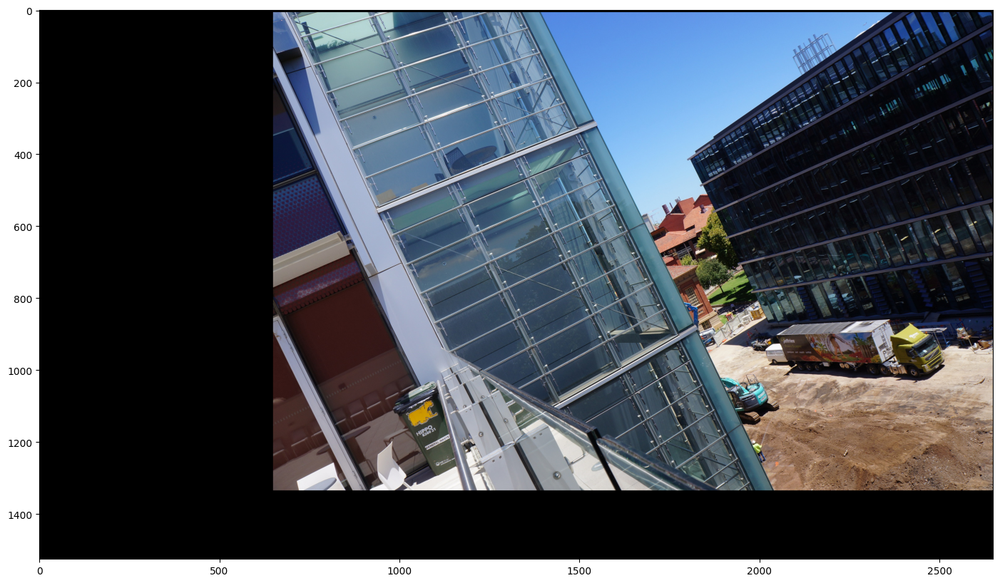

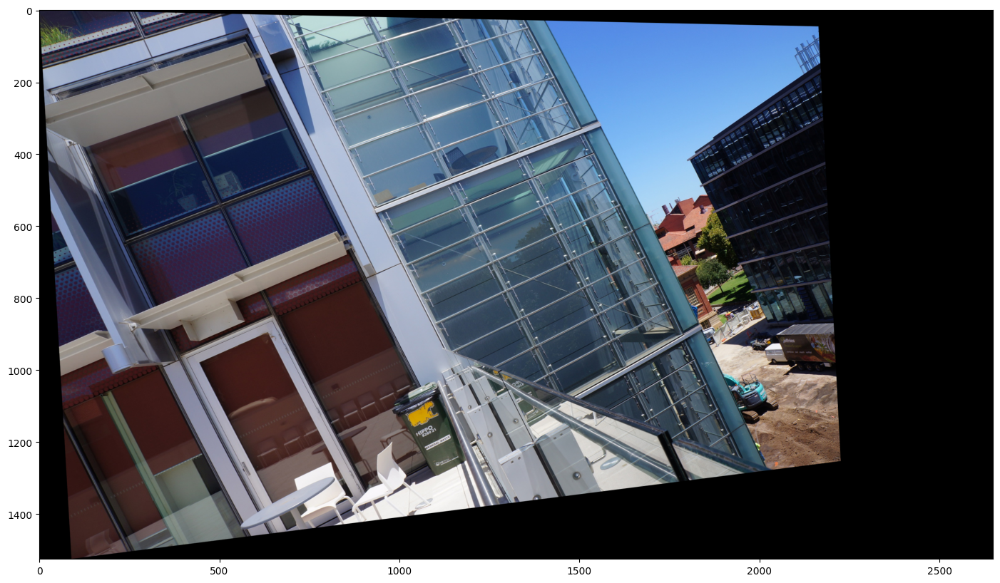

In [31]:
plot_image(query_warped, figsize=(20,10))
plot_image(train_warped, figsize=(20,10))

In [32]:
# Blending
mask = single_weights_matrix(img.shape[:2])

mask1 = cv2.warpPerspective(mask, translation01, (max_x-min_x, max_y-min_y))
mask2 = cv2.warpPerspective(mask,  translation01 @ H_inv01, (max_x-min_x, max_y-min_y))

mask1 = mask1/mask1.max()
mask2 = mask2/mask2.max()

normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
normalized_mask = normalized_mask/normalized_mask.max()

normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)

blended01 = normalized_mask * query_warped + (1-normalized_mask) * train_warped
blended01 = blended01.astype(np.uint8)
weights01 = (mask1 + mask2)/(mask1 + mask2).max()

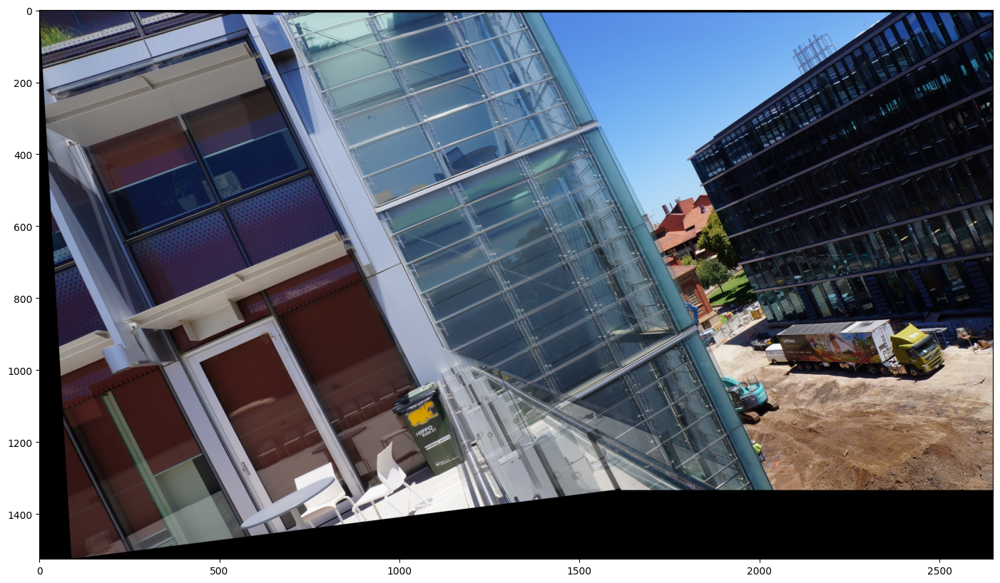

In [33]:
plot_image(blended01, figsize=(20,10))

In [34]:
h12 = np.linalg.inv(H_matrices[1])
h12 = h12/h12[-1,-1]
h12

array([[ 7.66105543e-01, -3.17878576e-02,  5.23514319e+02],
       [-4.27930030e-02,  9.11869649e-01,  7.58626899e+01],
       [-1.10471678e-04, -3.60308570e-06,  1.00000000e+00]])

In [35]:
# Canvas Size Calculation
H_inv12 = np.linalg.inv(h12)
corners = np.array([[0,0,1], [0,blended01.shape[0],1], [blended01.shape[1], blended01.shape[0],1], [blended01.shape[1], 0, 1]])
corners_ = np.dot(H_inv12 @ np.linalg.inv(translation01), corners.T).T # translation_matrices[2] @
corners_ = corners_/corners_[:,2].reshape(-1,1)
corners_

canvas_shape = blended234.shape # blended_images[2]
canvas_corners = np.array([[0,0,1], [0,canvas_shape[0],1], [canvas_shape[1], canvas_shape[0],1], [canvas_shape[1], 0, 1]])
canvas_corners_ = np.dot(np.linalg.inv(translation23), canvas_corners.T).T
all_corners = np.concatenate([canvas_corners_[:, :2], corners_[:, :2]], axis=0)
min_x = int(np.min(all_corners[:,0]))
max_x = int(np.max(all_corners[:,0]))
min_y = int(np.min(all_corners[:,1]))
max_y = int(np.max(all_corners[:,1]))

In [36]:
all_corners

array([[    0.        ,   -77.        ],
       [    0.        ,  1989.        ],
       [ 3748.        ,  1989.        ],
       [ 3748.        ,   -77.        ],
       [-1696.89201062,  -170.64526178],
       [-1600.47455395,  1791.28054557],
       [ 1529.84517844,  1364.6873722 ],
       [ 1495.39770501,   -18.51069083]])

In [37]:
min_x, max_x, min_y, max_y

(-1696, 3748, -170, 1989)

In [38]:
translation12 = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
train_warped = cv2.warpPerspective(blended01, translation12 @ H_inv12 @ np.linalg.inv(translation01), (max_x-min_x, max_y-min_y))

translation12 = translation12.astype(np.float32)
query_warped = cv2.warpPerspective(blended234, translation12 @ np.linalg.inv(translation23), (max_x-min_x, max_y-min_y))


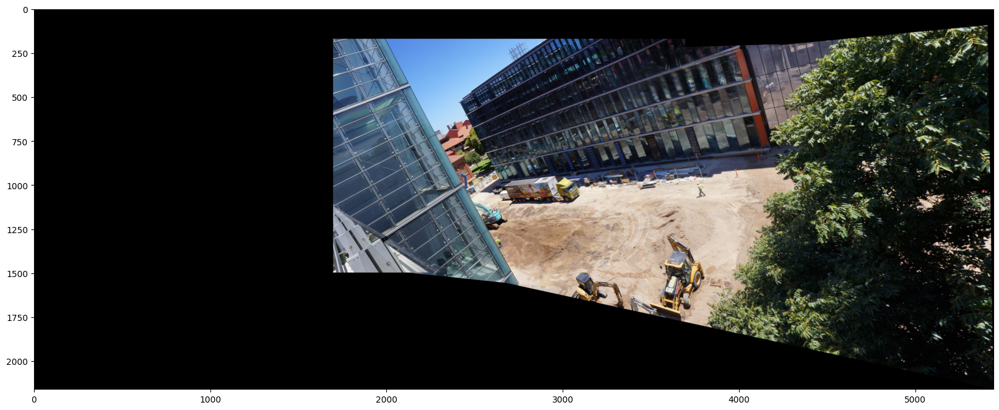

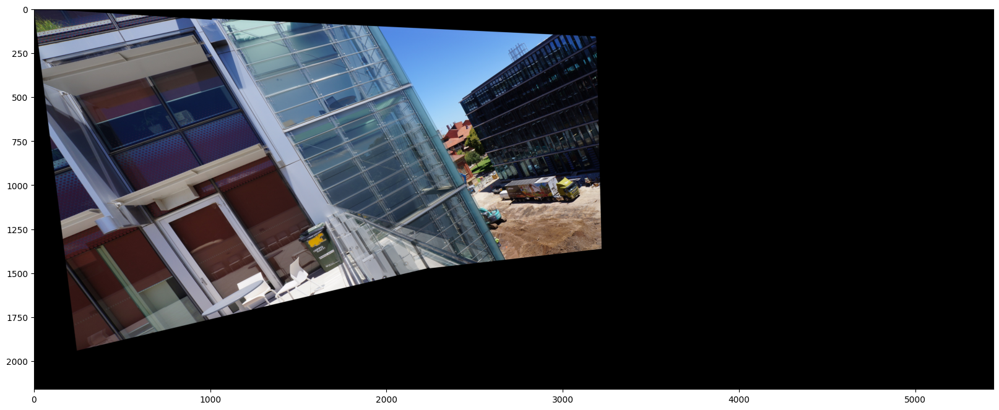

In [39]:
plot_image(query_warped, figsize=(20,10))
plot_image(train_warped, figsize=(20,10))

In [40]:
# Blending
# mask = single_weights_matrix(img.shape[:2])

mask1 = cv2.warpPerspective(weights234, translation12 @ np.linalg.inv(translation23), (max_x-min_x, max_y-min_y))
mask2 = cv2.warpPerspective(weights01, translation12 @ H_inv12 @ np.linalg.inv(translation01), (max_x-min_x, max_y-min_y))

mask1 = mask1/mask1.max()
mask2 = mask2/mask2.max()

normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
normalized_mask = normalized_mask/normalized_mask.max()

normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)

final_blended = normalized_mask * query_warped + (1-normalized_mask) * train_warped
final_blended = final_blended.astype(np.uint8)
final_weights = (mask1 + mask2)/(mask1 + mask2).max()

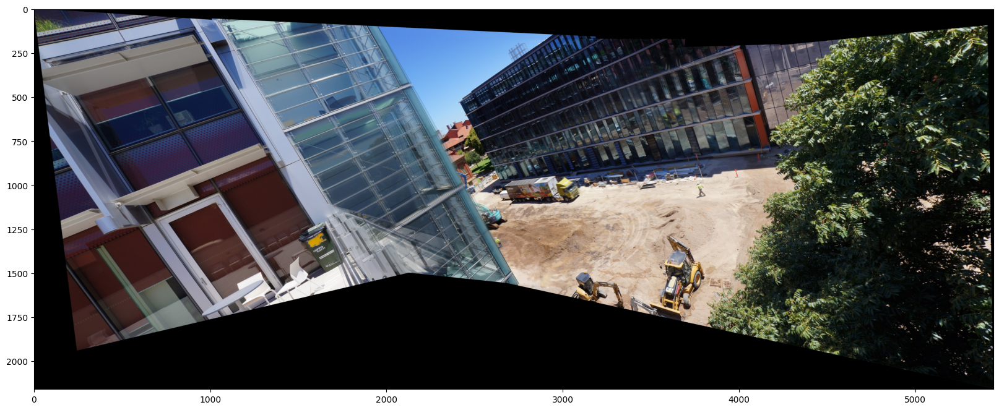

In [41]:
plot_image( final_blended, figsize=(20,10))

# GOD-FUNCTION

In [13]:
import glob
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from PIL import Image

In [14]:
def detect_sift_features(img):

    """
    Reference: CV2 Sift Features: https://docs.opencv.org/4.x/da/df5/tutorial_py_sift_intro.html
    """

    gray= cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()    
    kp, des = sift.detectAndCompute(gray,None)
    return (kp, des)
    
def plot_image(img, figsize = None, gray=False):
    if figsize != None:
        plt.figure(figsize=figsize)
    else:
        plt.figure()
    if gray:
        plt.imshow(img, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    # plt.axis('off')
    plt.show()

In [15]:
def cylindrical_warp(image, focal_length = 800):
    """
    References: 
    https://courses.cs.washington.edu/courses/cse576/08sp/lectures/Stitching.pdf
    https://youtu.be/taty6lPVcmA?si=DVuhGKr-9DYet8gi&t=3557
    """
    h, w = image.shape[:2]
    x_c, y_c = w // 2, h // 2

    u, v = np.meshgrid(np.arange(w), np.arange(h))

    theta = (u - x_c) / focal_length
    h_cyl = (v - y_c) / focal_length

    x_hat = np.sin(theta)
    y_hat = h_cyl
    z_hat = np.cos(theta)

    x_img = (focal_length * x_hat / z_hat + x_c).astype(np.int32)
    y_img = (focal_length * y_hat / z_hat + y_c).astype(np.int32)

    valid_mask = (x_img >= 0) & (x_img < w) & (y_img >= 0) & (y_img < h)

    cylindrical_img = np.zeros_like(image)
    cylindrical_img[v[valid_mask], u[valid_mask]] = image[y_img[valid_mask], x_img[valid_mask]]

    cylindrical_img = Image.fromarray(cylindrical_img)
    cylindrical_img = cylindrical_img.crop((u[valid_mask].min(), v[valid_mask].min(), u[valid_mask].max(), v[valid_mask].max()))
    cylindrical_img = np.array(cylindrical_img)

    return cylindrical_img

In [31]:
def RANSAC(query_coords, train_coords, epsilon = 5.0, s = 4, N = 1000):
    """
    RANSAC Algorithm to find the best homography matrix
    """
    best_inliers = []
    best_transform = None
    for i in tqdm(range(N)):
        # Randomly select s matches
        random_indices = np.random.choice(len(query_coords), s, replace=False)
        q = np.array([query_coords[i] for i in random_indices])
        t = np.array([train_coords[i] for i in random_indices])

        # Estimate homography matrix
        A = np.zeros((2*s, 9))
        for i in range(s):
            A[2*i] = np.array([-q[i][0], -q[i][1], -1, 0, 0, 0, q[i][0]*t[i][0], q[i][1]*t[i][0], t[i][0]])
            A[2*i+1] = np.array([0, 0, 0, -q[i][0], -q[i][1], -1, q[i][0]*t[i][1], q[i][1]*t[i][1], t[i][1]])
        
        U, S, V = np.linalg.svd(A)
        H = V[-1].reshape(3,3)
        
        q = np.hstack([np.array(query_coords), np.ones((len(query_coords), 1))])
        t_ = np.dot(H, q.T).T
        t_ = t_[:, :2] / t_[:, 2:]

        # Compute the number of inliers
        distances = np.linalg.norm(t_ - np.array(train_coords), axis=1)
        inliers = distances < epsilon
        if np.sum(inliers) > len(best_inliers):
            best_inliers = np.linspace(0, len(inliers), len(inliers), endpoint=False, dtype = np.int64)[inliers]
            best_transform = H
    
    A = np.zeros((2*len(best_inliers), 9))
    for i, inlier  in enumerate(best_inliers):
        A[2*i] = np.array([-query_coords[inlier][0], -query_coords[inlier][1], -1, 0, 0, 0, query_coords[inlier][0]*train_coords[inlier][0], query_coords[inlier][1]*train_coords[inlier][0], train_coords[inlier][0]])
        A[2*i+1] = np.array([0, 0, 0, -query_coords[inlier][0], -query_coords[inlier][1], -1, query_coords[inlier][0]*train_coords[inlier][1], query_coords[inlier][1]*train_coords[inlier][1], train_coords[inlier][1]])

    U, S, V = np.linalg.svd(A)
    best_transform = V[-1].reshape(3,3)
                                   
    return best_transform

In [17]:
# Reference: https://github.com/CorentinBrtx/image-stitching/tree/main
def single_weights_array(size: int) -> np.ndarray:
    if size % 2 == 1:
        return np.concatenate(
            [np.linspace(0, 1, (size + 1) // 2), np.linspace(1, 0, (size + 1) // 2)[1:]]
        )
    else:
        return np.concatenate([np.linspace(0, 1, size // 2), np.linspace(1, 0, size // 2)])


def single_weights_matrix(shape: tuple[int]) -> np.ndarray:
    return (
        single_weights_array(shape[0])[:, np.newaxis]
        @ single_weights_array(shape[1])[:, np.newaxis].T
    )

In [32]:
def stitch(path, a, b, focal_length, verbose = False):
    all_images = sorted(glob.glob(path+os.sep+'*'))
    if verbose:
        print('Found {} Images for stitching'.format(len(all_images)))

    query_image_idx = a
    train_image_idx = b

    # Feature detection
    images_with_sift = []
    for i in range(len(all_images)):
        img = cv2.imread(all_images[i])
        img = cylindrical_warp(img, focal_length)
        images_with_sift.append(detect_sift_features(img))
    if verbose:
        print('Feature Detection Done')

    # Feature Matching
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(images_with_sift[query_image_idx][1], images_with_sift[train_image_idx][1], k=2)
    # Ratio Test
    good = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good.append([m])
    if verbose:
        print('Feature Matching Done')

    # Feature Coodinates Extraction 
    query_coords = []
    train_coords = []
    for i in range(len(good)):
        query_coords.append(images_with_sift[query_image_idx][0][good[i][0].queryIdx].pt)
        train_coords.append(images_with_sift[train_image_idx][0][good[i][0].trainIdx].pt)
    if verbose:
        print('Feature Coordinates Extraction Done')

    # Homography Estimation
    H = RANSAC(query_coords, train_coords, epsilon = 5.0, s = 4, N = 1000)
    if verbose:
        print('Homography Estimation Done')
    return  H

In [58]:
def stitch_images( H_matrices, images, reference_image_idx):
        
    # Left Stitching
    left_stitched_img = (images[0].copy()).astype(np.uint8)
    left_translation_matrices = []
    left_weight_matrix = single_weights_matrix(images[0].shape[:2])
    for i in range(0, reference_image_idx):
        H = H_matrices[i]
        H = H/H[-1,-1]
        train_corners = np.array([[0,0,1], [0,left_stitched_img.shape[0],1], [left_stitched_img.shape[1], left_stitched_img.shape[0],1], [left_stitched_img.shape[1], 0, 1]])
        if i != 0:
            warped_corners = np.dot(H @ np.linalg.inv(left_translation_matrices[-1]), train_corners.T).T
        else:
            warped_corners = np.dot(H, train_corners.T).T
        warped_corners = warped_corners/warped_corners[:,2].reshape(-1,1)
        query_corners = np.array([[0,0,1], [0,images[i+1].shape[0],1], [images[i+1].shape[1], images[i+1].shape[0],1], [images[i+1].shape[1], 0, 1]])
        all_corners = np.concatenate([query_corners[:, :2], warped_corners[:, :2]], axis=0)
        min_x = int(np.min(all_corners[:,0]))
        max_x = int(np.max(all_corners[:,0]))
        min_y = int(np.min(all_corners[:,1]))
        max_y = int(np.max(all_corners[:,1]))

        translation = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
        translation = translation.astype(np.float32)
        left_translation_matrices.append(translation.copy())
        if i != 0:
            train_warped = cv2.warpPerspective(left_stitched_img, left_translation_matrices[-1] @ H @ np.linalg.inv(left_translation_matrices[-2]), (max_x-min_x, max_y-min_y))
        else:
            train_warped = cv2.warpPerspective(left_stitched_img, left_translation_matrices[-1] @ H, (max_x-min_x, max_y-min_y))
        query_warped = cv2.warpPerspective(images[i+1], left_translation_matrices[-1], (max_x-min_x, max_y-min_y))

        mask1 = single_weights_matrix(images[i].shape[:2])
        mask2 = single_weights_matrix(images[i+1].shape[:2])
        if i != 0:
            train_mask = cv2.warpPerspective(left_weight_matrix, left_translation_matrices[-1] @ H @ np.linalg.inv(left_translation_matrices[-2]), (max_x-min_x, max_y-min_y))
        else:
            train_mask = cv2.warpPerspective(mask1, left_translation_matrices[-1] @ H, (max_x-min_x, max_y-min_y))
        query_mask = cv2.warpPerspective(mask2, left_translation_matrices[-1], (max_x-min_x, max_y-min_y))
        
        train_mask = (train_mask/train_mask.max()).astype(np.float32)
        query_mask = (query_mask/query_mask.max()).astype(np.float32)
        normalized_mask = np.divide(train_mask, train_mask+query_mask, where=(train_mask+query_mask)!=0)
        normalized_mask = normalized_mask/normalized_mask.max()
        normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)
        left_weight_matrix = (train_mask + query_mask)/(train_mask + query_mask).max()
        
        left_stitched_img = normalized_mask * train_warped + (1-normalized_mask) * query_warped
        left_stitched_img = left_stitched_img.astype(np.uint8)

        # del train_mask, query_mask, train_warped, query_warped, normalized_mask

    # Right Stitching
    right_stitched_img = (images[-1].copy()).astype(np.uint8)
    right_translation_matrices = []
    right_weight_matrix = single_weights_matrix(images[-1].shape[:2])
    for i in range(len(H_matrices)-1, reference_image_idx, -1):
        H = np.linalg.inv(H_matrices[i])
        H = H/H[-1,-1]
        train_corners = np.array([[0,0,1], [0,right_stitched_img.shape[0],1], [right_stitched_img.shape[1], right_stitched_img.shape[0],1], [right_stitched_img.shape[1], 0, 1]])
        if i != len(H_matrices)-1:
            warped_corners = np.dot(H @ np.linalg.inv(right_translation_matrices[-1]), train_corners.T).T
        else:
            warped_corners = np.dot(H, train_corners.T).T
        warped_corners = warped_corners/warped_corners[:,2].reshape(-1,1)
        query_corners = np.array([[0,0,1], [0,images[i].shape[0],1], [images[i].shape[1], images[i].shape[0],1], [images[i].shape[1], 0, 1]])
        all_corners = np.concatenate([query_corners[:, :2], warped_corners[:, :2]], axis=0)
        min_x = int(np.min(all_corners[:,0]))
        max_x = int(np.max(all_corners[:,0]))
        min_y = int(np.min(all_corners[:,1]))
        max_y = int(np.max(all_corners[:,1]))

        translation = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
        translation = translation.astype(np.float32)
        right_translation_matrices.append(translation.copy())
        if i != len(H_matrices)-1:
            train_warped = cv2.warpPerspective(right_stitched_img, right_translation_matrices[-1] @ H @ np.linalg.inv(right_translation_matrices[-2]), (max_x-min_x, max_y-min_y))
        else:
            train_warped = cv2.warpPerspective(right_stitched_img, right_translation_matrices[-1] @ H, (max_x-min_x, max_y-min_y))
        query_warped = cv2.warpPerspective(images[i], right_translation_matrices[-1], (max_x-min_x, max_y-min_y))
        
        mask1 = single_weights_matrix(images[i+1].shape[:2])
        mask2 = single_weights_matrix(images[i].shape[:2])
        if i != len(H_matrices)-1:
            train_mask = cv2.warpPerspective(right_weight_matrix, right_translation_matrices[-1] @ H @ np.linalg.inv(right_translation_matrices[-2]), (max_x-min_x, max_y-min_y))
        else:
            train_mask = cv2.warpPerspective(mask1, right_translation_matrices[-1] @ H, (max_x-min_x, max_y-min_y))
        query_mask = cv2.warpPerspective(mask2, right_translation_matrices[-1], (max_x-min_x, max_y-min_y))
        
        train_mask = (train_mask/train_mask.max()).astype(np.float32)
        query_mask = (query_mask/query_mask.max()).astype(np.float32)
        normalized_mask = np.divide(train_mask, train_mask+query_mask, where=(train_mask+query_mask)!=0)
        normalized_mask = normalized_mask/normalized_mask.max()
        normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)
        right_weight_matrix = (train_mask + query_mask)/(train_mask + query_mask).max()

        right_stitched_img = normalized_mask * train_warped + (1-normalized_mask) * query_warped
        right_stitched_img = right_stitched_img.astype(np.uint8)

        # del train_mask, query_mask, train_warped, query_warped, normalized_mask
    
    # Final Stitching
    if reference_image_idx == len(H_matrices):
        return left_stitched_img
    else:
        H = np.linalg.inv(H_matrices[reference_image_idx])
        H = H/H[-1,-1]
        train_corners = np.array([[0,0,1], [0,right_stitched_img.shape[0],1], [right_stitched_img.shape[1], right_stitched_img.shape[0],1], [right_stitched_img.shape[1], 0, 1]])
        if reference_image_idx != len(H_matrices)-1:
            warped_corners = np.dot(H @ np.linalg.inv(right_translation_matrices[-1]), train_corners.T).T
        else:
            warped_corners = np.dot(H, train_corners.T).T
        warped_corners = warped_corners/warped_corners[:,2].reshape(-1,1)
        query_corners = np.array([[0,0,1], [0,left_stitched_img.shape[0],1], [left_stitched_img.shape[1], left_stitched_img.shape[0],1], [left_stitched_img.shape[1], 0, 1]])
        if reference_image_idx != 0:
            query_corners = np.dot(np.linalg.inv(left_translation_matrices[-1]), query_corners.T).T
        all_corners = np.concatenate([query_corners[:, :2], warped_corners[:, :2]], axis=0)
        min_x = int(np.min(all_corners[:,0]))
        max_x = int(np.max(all_corners[:,0]))
        min_y = int(np.min(all_corners[:,1]))
        max_y = int(np.max(all_corners[:,1]))

        translation = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
        translation = translation.astype(np.float32)
        right_translation_matrices.append(translation.copy())
        if reference_image_idx != len(H_matrices)-1:
            train_warped = cv2.warpPerspective(right_stitched_img, right_translation_matrices[-1] @ H @ np.linalg.inv(right_translation_matrices[-2]), (max_x-min_x, max_y-min_y))
        else:
            train_warped = cv2.warpPerspective(right_stitched_img, right_translation_matrices[-1] @ H, (max_x-min_x, max_y-min_y))
        if reference_image_idx != 0:
            query_warped = cv2.warpPerspective(left_stitched_img, right_translation_matrices[-1] @ np.linalg.inv(left_translation_matrices[-1]), (max_x-min_x, max_y-min_y))
        else:
            query_warped = cv2.warpPerspective(left_stitched_img, right_translation_matrices[-1], (max_x-min_x, max_y-min_y))
        
        mask = single_weights_matrix(images[-1].shape[:2])
        if reference_image_idx != len(H_matrices)-1:
            train_mask = cv2.warpPerspective(right_weight_matrix, right_translation_matrices[-1] @ H @ np.linalg.inv(right_translation_matrices[-2]), (max_x-min_x, max_y-min_y))
        else:
            train_mask = cv2.warpPerspective(mask, right_translation_matrices[-1] @ H, (max_x-min_x, max_y-min_y))
        if reference_image_idx != 0:
            query_mask = cv2.warpPerspective(left_weight_matrix, right_translation_matrices[-1] @ np.linalg.inv(left_translation_matrices[-1]), (max_x-min_x, max_y-min_y))
        else:
            query_mask = cv2.warpPerspective(mask, right_translation_matrices[-1], (max_x-min_x, max_y-min_y))
        
        train_mask = (train_mask/train_mask.max()).astype(np.float32)
        query_mask = (query_mask/query_mask.max()).astype(np.float32)
        normalized_mask = np.divide(train_mask, train_mask+query_mask, where=(train_mask+query_mask)!=0)
        normalized_mask = normalized_mask/normalized_mask.max()
        normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)
        # final_weight_matrix = (train_mask + query_mask)/(train_mask + query_mask).max()

        final_stitched_img = normalized_mask * train_warped + (1-normalized_mask) * query_warped
        final_stitched_img = final_stitched_img.astype(np.uint8)

        del train_mask, query_mask, train_warped, query_warped, normalized_mask

    return final_stitched_img

In [65]:
path = '../../Images/I6'
focal_length = 800
H_matrices = []
for i in range(len(os.listdir(path))-1):
    H = compute_homography(path, i, i+1, cylinder_warp=False, focal_length=focal_length)
    H_matrices.append(H)

100%|██████████| 1000/1000 [00:00<00:00, 3115.27it/s]


In [66]:
all_images = sorted(glob.glob(path+os.sep+'*'))
images = []
for i in range(len(all_images)):
    img = cv2.imread(all_images[i])
    # img = cylindrical_warp(img, focal_length=focal_length)
    images.append(img)

In [67]:
final_stitch = stitch_images(H_matrices, images, 2)

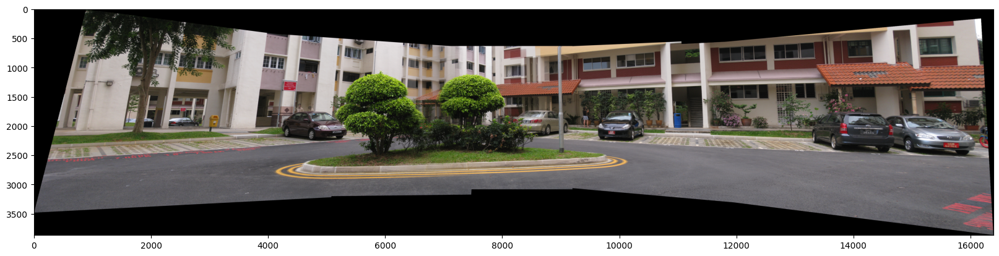

In [43]:
plot_image(final_stitch, figsize=(20,10))

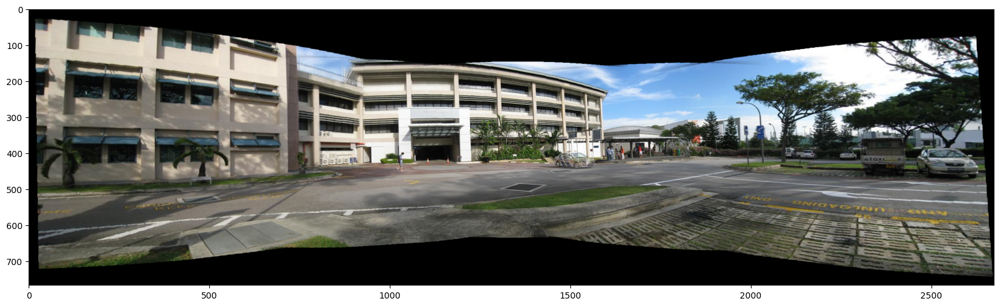

In [47]:
plot_image(final_stitch, figsize=(20,10))

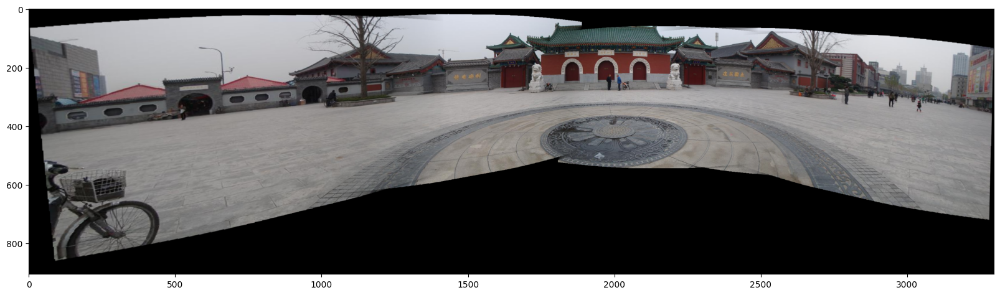

In [51]:
plot_image(final_stitch, figsize=(20,10))

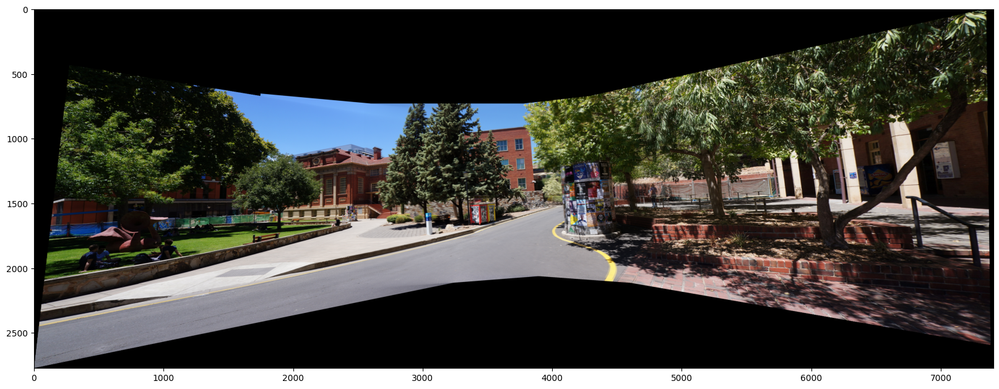

In [60]:
plot_image(final_stitch, figsize=(20,10))

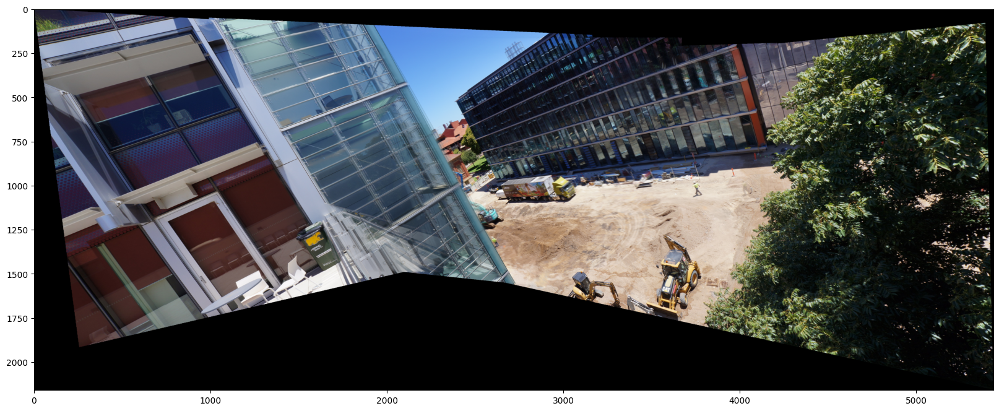

In [64]:
plot_image(final_stitch, figsize=(20,10))

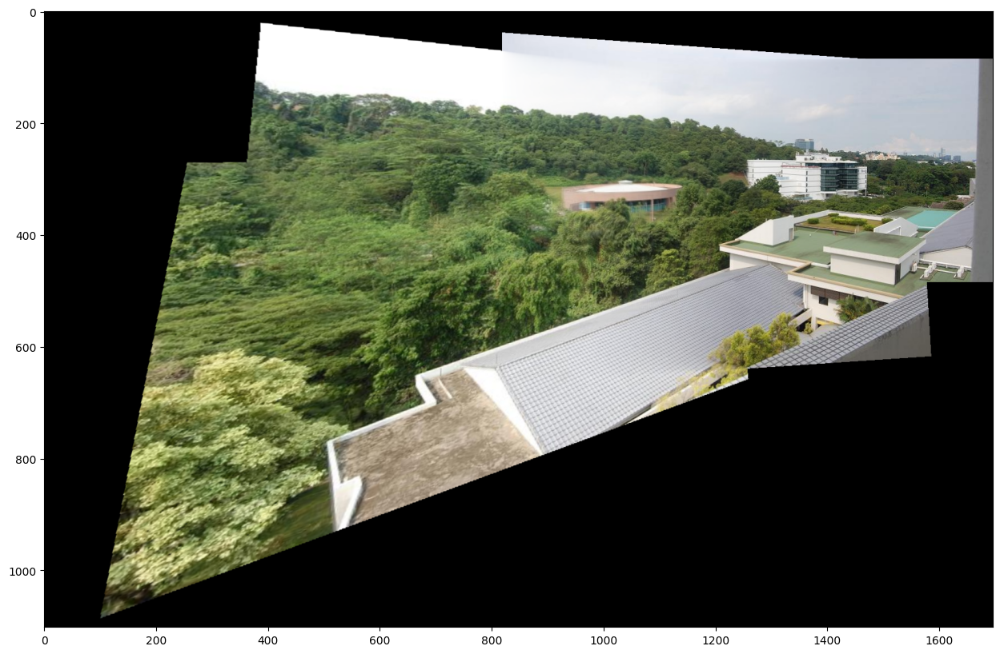

In [68]:
plot_image(final_stitch, figsize=(20,10))

# EXTRAS

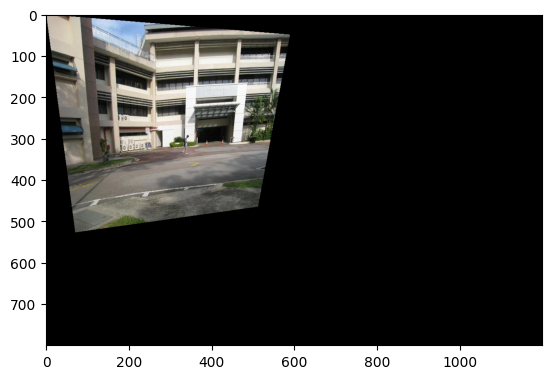

In [39]:
import numpy as np
import cv2
import matplotlib.pylab as plt

def warp_perspective(image, homography_matrix, canvas_size):
    # Get the dimensions of the canvas
    width, height = canvas_size
    warped_image = np.zeros((height, width, 3), dtype=np.uint8)

    # Inverse of the homography matrix
    H_inv = np.linalg.inv(homography_matrix)

    # Generate a grid of (x, y) coordinates in the destination image
    x, y = np.meshgrid(np.arange(width), np.arange(height))
    ones = np.ones_like(x)
    dest_points = np.stack([x, y, ones], axis=-1).reshape(-1, 3)  # Shape (height * width, 3)

    # Map the destination points back to the source image using the inverse homography
    src_points = H_inv @ dest_points.T  # Shape (3, height * width)
    src_points /= src_points[2, :]  # Normalize by the third (homogeneous) coordinate
    src_x = src_points[0, :].reshape(height, width)
    src_y = src_points[1, :].reshape(height, width)

    # Perform bilinear interpolation
    x0 = np.floor(src_x).astype(int)
    x1 = x0 + 1
    y0 = np.floor(src_y).astype(int)
    y1 = y0 + 1

    # Clip to be within the bounds of the source image
    x0 = np.clip(x0, 0, image.shape[1] - 1)
    x1 = np.clip(x1, 0, image.shape[1] - 1)
    y0 = np.clip(y0, 0, image.shape[0] - 1)
    y1 = np.clip(y1, 0, image.shape[0] - 1)

    # Get pixel values at each corner
    Ia = image[y0, x0]  # Top-left
    Ib = image[y1, x0]  # Bottom-left
    Ic = image[y0, x1]  # Top-right
    Id = image[y1, x1]  # Bottom-right

    # Calculate the distances from each point to the integer coordinates
    wa = (x1 - src_x) * (y1 - src_y)
    wb = (x1 - src_x) * (src_y - y0)
    wc = (src_x - x0) * (y1 - src_y)
    wd = (src_x - x0) * (src_y - y0)

    # Compute the interpolated pixel values
    warped_image = (Ia * wa[..., np.newaxis] + 
                    Ib * wb[..., np.newaxis] + 
                    Ic * wc[..., np.newaxis] + 
                    Id * wd[..., np.newaxis]).astype(np.uint8)

    return warped_image

# Example usage
image = cv2.imread("../../Images/I2/2_2.JPG")
canvas_size = (1200, 800)  # Set desired output canvas size

# Define an example homography matrix
homography_matrix = np.array([[1.2, 0.2, 0],
                              [0.1, 1.5, 0],
                              [0.0005, 0.0008, 1]])

# Apply the perspective warp
warped_image = warp_perspective(image, homography_matrix, canvas_size)

# Display the result
plt.imshow(cv2.cvtColor(warped_image, cv2.COLOR_BGR2RGB))
plt.show()


In [25]:
def compute_homography(path, a, b, cylinder_warp = False, focal_length = 800, verbose=False):
    all_images = sorted(glob.glob(path + os.sep + '*'))
    if verbose:
        print('Found {} Images for stitching'.format(len(all_images)))

    query_image_idx = a
    train_image_idx = b

    # Feature detection
    images_with_sift = []
    for i in range(len(all_images)):
        img = cv2.imread(all_images[i])
        if cylinder_warp:
            img = cylindrical_warp(img, focal_length)
        images_with_sift.append(detect_sift_features(img))
    if verbose:
        print('Feature Detection Done')

    # Feature Matching
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(images_with_sift[query_image_idx][1], images_with_sift[train_image_idx][1], k=2)
    # Ratio Test
    good = [m for m, n in matches if m.distance < 0.75 * n.distance]
    if verbose:
        print('Feature Matching Done')

    # Feature Coordinates Extraction
    query_coords = np.array([images_with_sift[query_image_idx][0][m.queryIdx].pt for m in good])
    train_coords = np.array([images_with_sift[train_image_idx][0][m.trainIdx].pt for m in good])
    if verbose:
        print('Feature Coordinates Extraction Done')

    # Homography Estimation
    H = RANSAC(query_coords, train_coords, epsilon=5.0, s=4, N=1000)
    if verbose:
        print('Homography Estimation Done')
    return H
